In [1]:
import numpy as np
import os, sys
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')
import pandas as pd
from scipy.stats import ranksums, wilcoxon
from sklearn.cluster import KMeans
from statsmodels.multivariate.manova import MANOVA
from scipy.stats import spearmanr, linregress, wilcoxon
import seaborn as sns
from matplotlib.colors import ListedColormap
from sklearn.cluster import OPTICS, DBSCAN
# flatui = ["#9b59b6", "#3498db", "#95a5a6", "#e74c3c", "#34495e", "#2ecc71"]
# my_cmap = ListedColormap(sns.color_palette(flatui).as_hex())
sns.set(font_scale=1.5, style='ticks')
%load_ext autoreload
%autoreload 2
%matplotlib inline
def moving_average(x, win, axis=0):
    return pd.DataFrame(x).rolling(win, win_type='boxcar', center=False, min_periods=1, axis=axis).mean().to_numpy()

### mask cells

In [2]:
df = pd.read_csv('../Processing/data_list_in_analysis.csv')

row = df.iloc[1]
save_root = row['save_dir']+'/'
print(row['taskType'])
print(save_root)

LG_vs_NGGU
/nrs/ahrens/Ziqiang/Jing_Glia_project/Processed_data/20191130/fish00/6dpf_HuC-GC7FF_GU-fwd_fish00_exp05_20191130_194544//


In [3]:
_ = np.load(save_root+'cell_dff.npz', allow_pickle=True)
A = _['A']
A_loc = _['A_loc']
# dFF = _['dFF'].astype('float')
num_dff = _['dFF'].shape[-1]
_ = None

brain_map = np.load(save_root+'Y_ave.npy').astype('float').squeeze()
A_center = np.load(save_root+'cell_center.npy')
A_center_grid = np.round(A_center).astype('int')
cells_in_mask = []

for n_layer in range(brain_map.shape[0]):
    layer_ = A_center[:, 0]==n_layer
    cell_ids = np.where(layer_)[0]
    mask_ = brain_map[n_layer]>2
    y = A_center_grid[cell_ids, 2]
    x = A_center_grid[cell_ids, 1]
    x_max, y_max = mask_.shape
    num_cells = len(cell_ids)
    in_mask_ = np.zeros(num_cells).astype('bool')
    for n in range(num_cells):
        if (x[n]<x_max) and (y[n]<y_max):
            in_mask_[n] = mask_[x[n], y[n]]
    cells_in_mask.append(cell_ids[in_mask_])
cells_in_mask = np.concatenate(cells_in_mask)
A_center = A_center[cells_in_mask]
# dFF = dFF[cells_in_mask]
num_cells = A_center.shape[0]

In [76]:
np.savez('cell_label', cells_in_mask=cells_in_mask, mpulse_=mpulse_, mpulse_labels=mpulse_labels)

In [72]:
np.unique(mpulse_labels, return_counts=True)

(array([0, 1, 3, 4, 5], dtype=int32), array([4922, 3056, 2816,  906, 2352]))

### Precomptued neuron selectivity

In [4]:
### multi-pulse sensory
_ = np.load(save_root+'cell_type_stats_msensory.npz', allow_pickle=True)
cell_msensory_stats=_['cell_msensory_stats']

## sensory
_ = np.load(save_root+'cell_type_stats_sensory.npz', allow_pickle=True)
cell_sensory_stats=_['cell_sensory_stats']

if os.path.exists(save_root+'cell_type_stats_pulse_motor.npz'):
    _ = np.load(save_root+'cell_type_stats_pulse_motor.npz', allow_pickle=True)
    cell_pulse_motor_stats=_['cell_pulse_motor_stats']
    _ = np.load(save_root+'cell_comp_pulse_motor_stats_.npz', allow_pickle=True)
    cell_comp_pulse_motor_stats=_['cell_comp_pulse_motor_stats']

## motor
_ = np.load(save_root+'cell_type_stats_sm.npz', allow_pickle=True)
cell_sm_stats=_['cell_sm_stats']
_ = np.load(save_root+'cell_type_stats_motor.npz', allow_pickle=True)
cell_motor_stats=_['cell_motor_stats']

## Sensory neurons

In [5]:
mpulse_vec_sel = np.zeros(num_cells).astype('int')
mpulse_ave_sel_ = np.zeros(num_cells).astype('int')
mpulse_ave_sel_baseline = np.ones(num_cells).astype('int')
t_post = 50
t_pre = 5
t_len_ = t_post+t_pre

for n in range(num_cells):
    mpulse_vec_sel[n] = (cell_msensory_stats[n][1][0][t_pre:]<0.05).sum()
    mpulse_ave_sel_[n] = (cell_msensory_stats[n][1][1][t_pre:]<0.05).sum()
    mpulse_ave_sel_baseline[n] = (cell_msensory_stats[n][1][2][t_pre:]>0.1).sum()

In [6]:
win_ = 10
idx_base_ = (mpulse_ave_sel_>win_) & (mpulse_ave_sel_baseline>t_post-5) # neuron response during pulse but no response during no pulse
idx_diff_ = (mpulse_vec_sel>win_) & (mpulse_ave_sel_>win_)
arr_ = idx_base_ | idx_diff_ 
# arr_ = idx_diff_ 

pulse_resp = np.zeros((num_cells, t_len_))
nopulse_resp = np.zeros((num_cells, t_len_))

for n in range(num_cells):
    pulse_resp[n] = cell_msensory_stats[n][3]
    nopulse_resp[n] = cell_msensory_stats[n][4]

In [7]:
trend_ = nopulse_resp[arr_]
trend_ = moving_average(trend_, 5, axis=1)
resp_ = pulse_resp[arr_]
resp_ = resp_ - trend_
pulse_resp_norm = resp_/np.abs(resp_).max(axis=-1, keepdims=True)

n_clusters = 30
kmeans = KMeans(n_clusters=n_clusters, random_state=0).fit(pulse_resp_norm)
cluster_corr_thres = []
for n in range(n_clusters-1):
    corr_, p_val_ = spearmanr(pulse_resp_norm[kmeans.labels_==n], axis=1)
    cluster_corr_thres.append(corr_.mean())
corr_thres = np.mean(cluster_corr_thres)
labels = kmeans.labels_.copy()
# for n in range(n_clusters-1):
#     if (labels==n).sum()==0:
#         continue
#     if cluster_corr_thres[n]<corr_thres:
#         continue
#     for m in range(n+1, n_clusters):
#         m_cell = (labels==m).sum()
#         corr_, p_val_ = spearmanr(pulse_resp_norm[labels==m], pulse_resp_norm[labels==n], axis=1)
#         if corr_[:m_cell, m_cell:].mean()>(cluster_corr_thres[n]*0.85):
#             labels[labels==m]=n
ulabels, num_ = np.unique(labels, return_counts=True)
# ulabels = ulabels[num_>200]
for n, l in enumerate(ulabels):
    labels[labels==l]=n

In [8]:
mpulse_ = arr_.copy()
mpulse_labels_ = labels.copy()

0


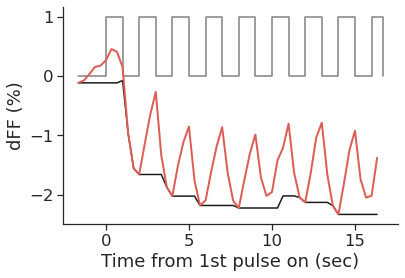

1


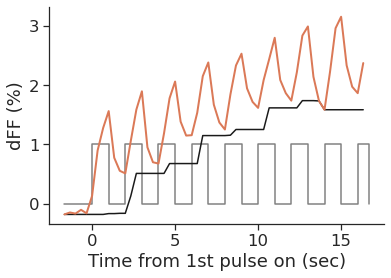

2


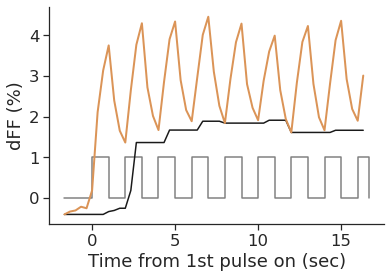

3


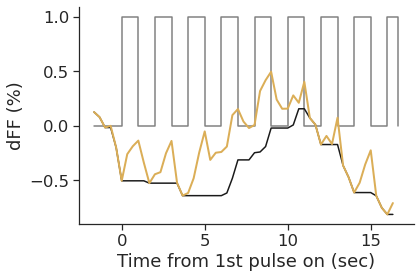

4


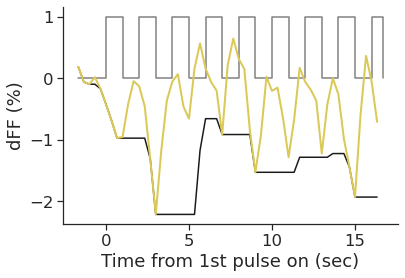

5


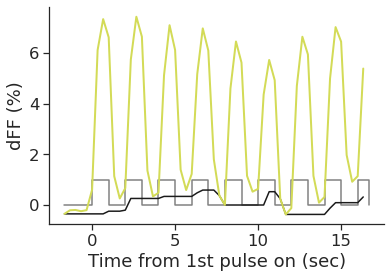

6


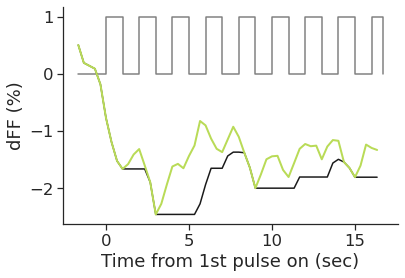

7


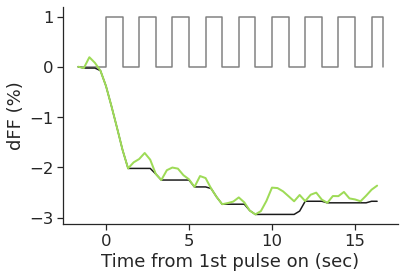

8


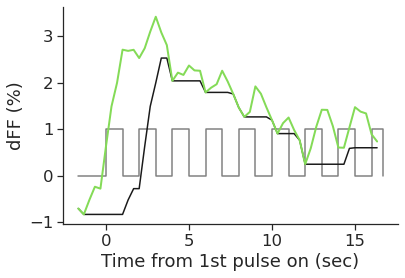

9


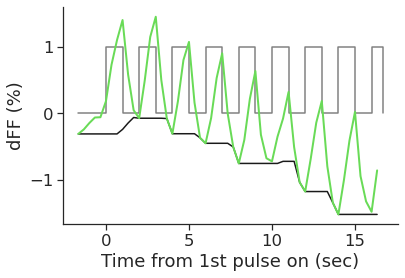

10


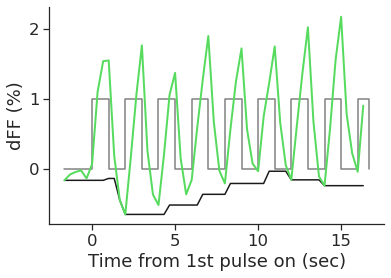

11


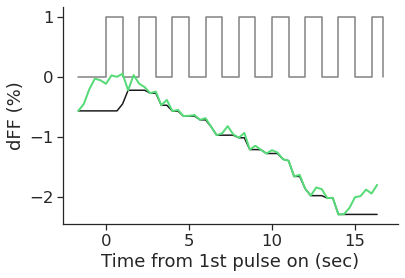

12


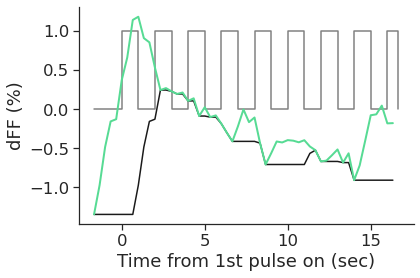

13


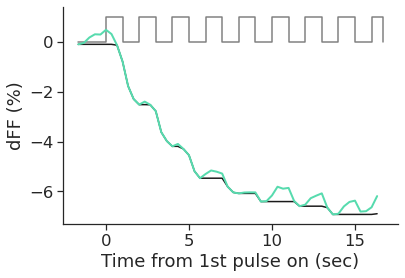

14


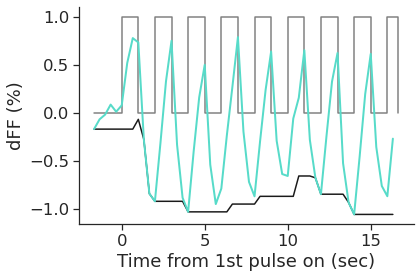

15


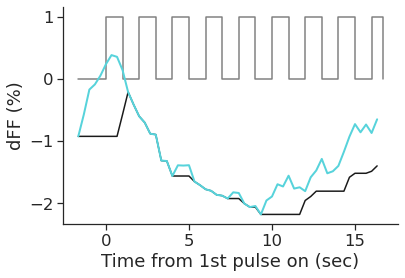

16


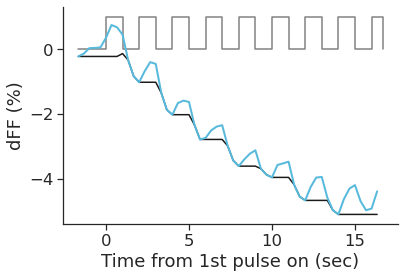

17


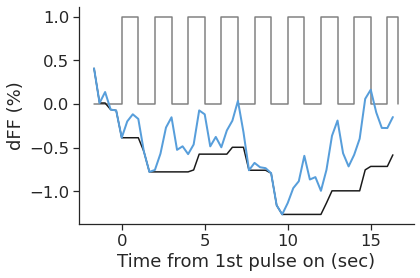

18


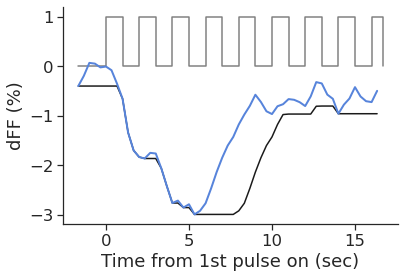

19


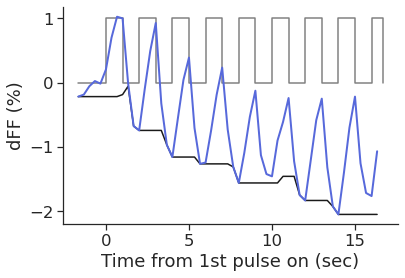

20


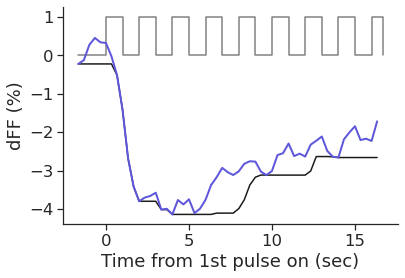

21


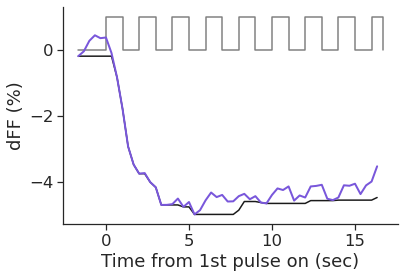

22


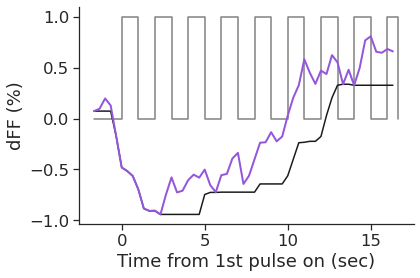

23


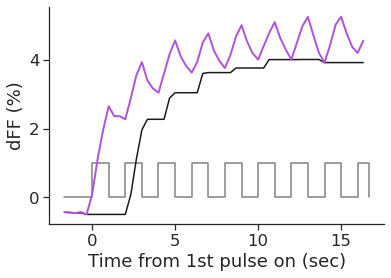

24


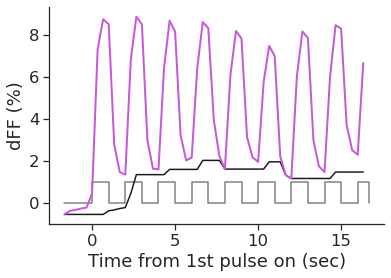

25


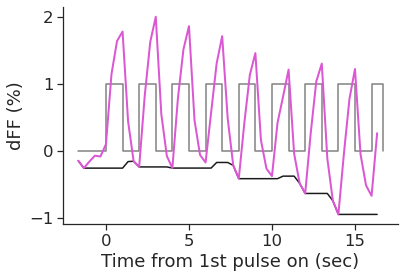

26


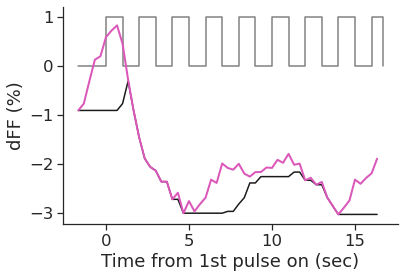

27


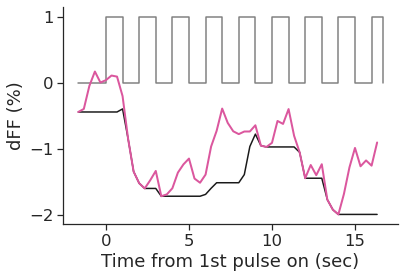

28


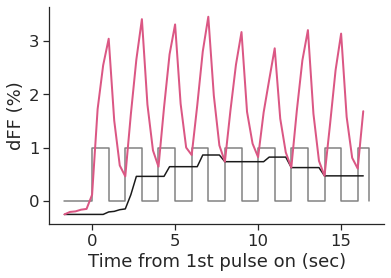

29


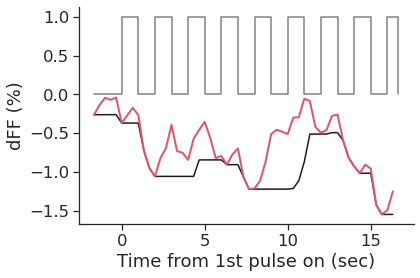

In [9]:
m_clusters = len(np.unique(mpulse_labels_))
my_cmap = ListedColormap(sns.color_palette("hls", m_clusters).as_hex())
pulse_t = np.r_[-t_pre/3, np.arange(t_post/3), t_post/3]
pulse_a = np.r_[0, (np.arange(t_post/3)+1)%2, (np.rint(t_post/3)+1)%2]
for m in range(m_clusters):
    print(m)
    plt.step(pulse_t, pulse_a, c='gray', where='post')
    trend_ = np.mean(nopulse_resp[mpulse_][mpulse_labels_==m],axis=0)[:,None]
    trend_ = moving_average(trend_, 5).squeeze()
    resp_ = np.mean(pulse_resp[mpulse_][mpulse_labels_==m],axis=0)
    resp_ = resp_ - trend_
    resp_low = pd.Series(resp_).rolling(8, center=False, min_periods=1).quantile(.05, interpolation='lower')
    trend_ = moving_average(resp_low, 20)
    plt.plot(np.arange(-t_pre, t_post)/3, resp_low*100, '-k')
    plt.plot(np.arange(-t_pre, t_post)/3, resp_*100, '-', c=my_cmap.colors[m], lw=2)
    plt.ylabel('dFF (%)')
    plt.xlabel('Time from 1st pulse on (sec)')
    sns.despine()
    plt.savefig(f'pulse_resp_{m}.svg')
    plt.show()

0


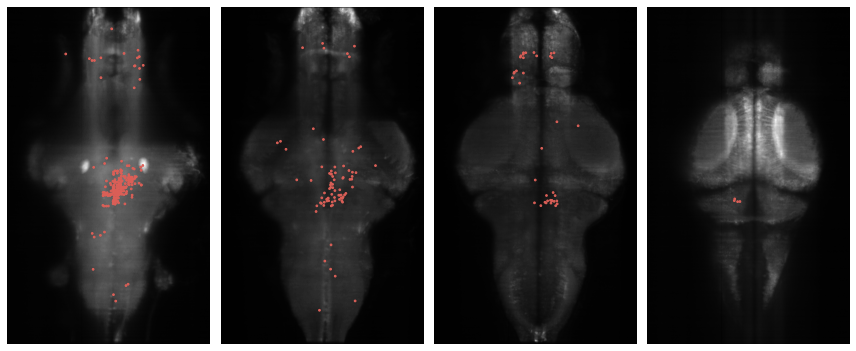

1


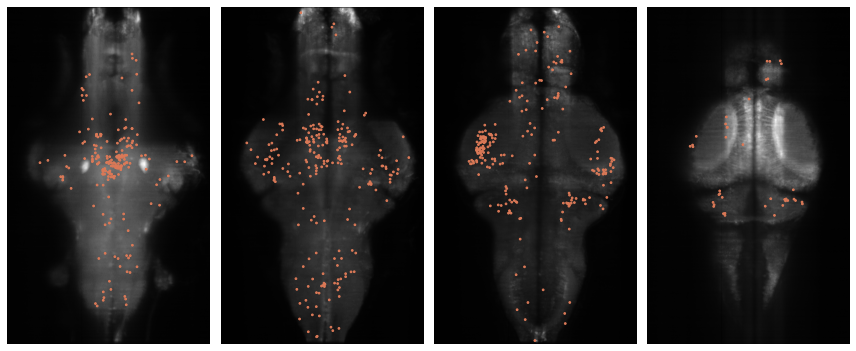

2


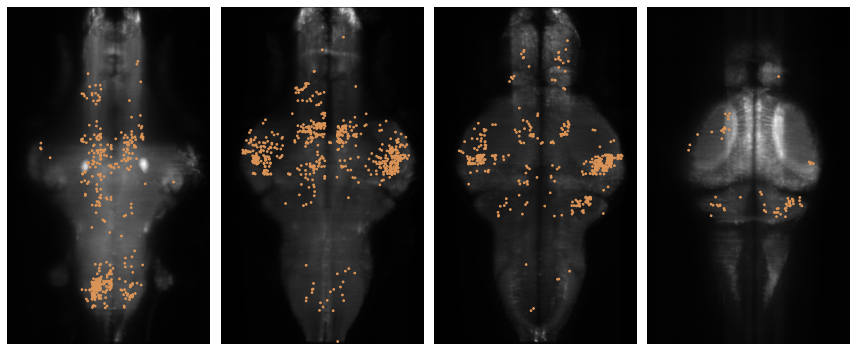

3


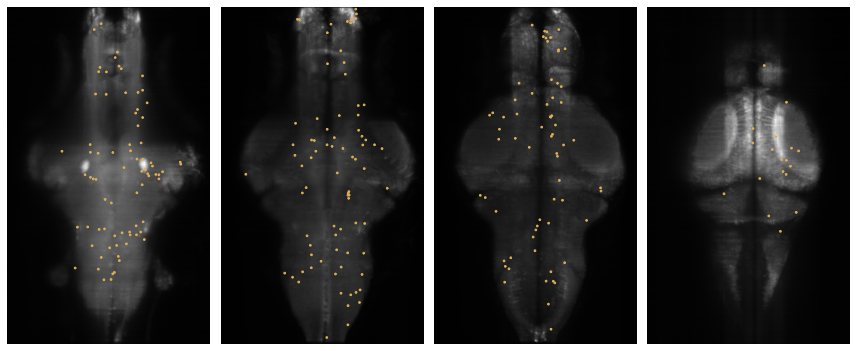

4


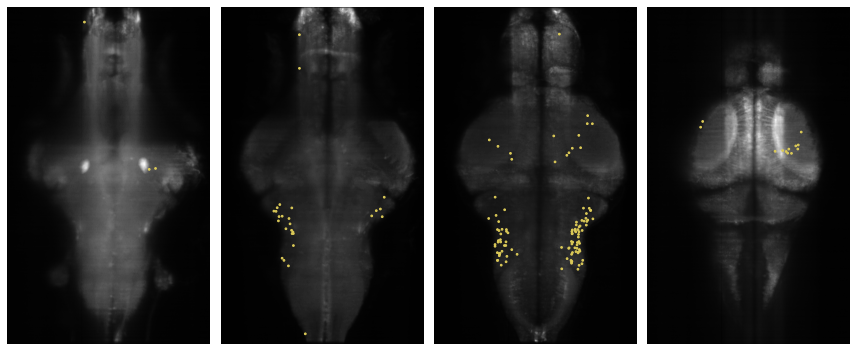

5


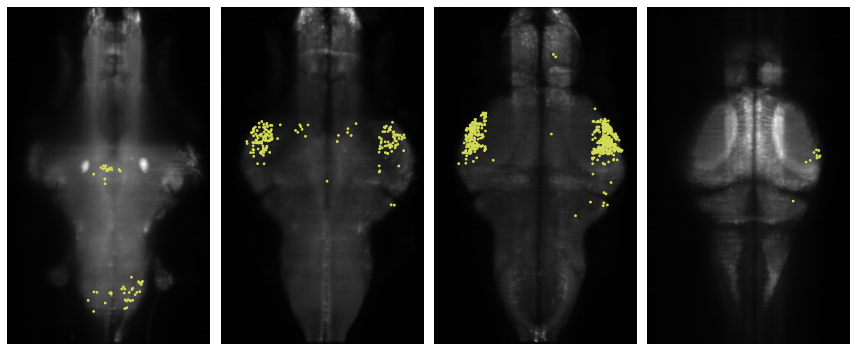

6


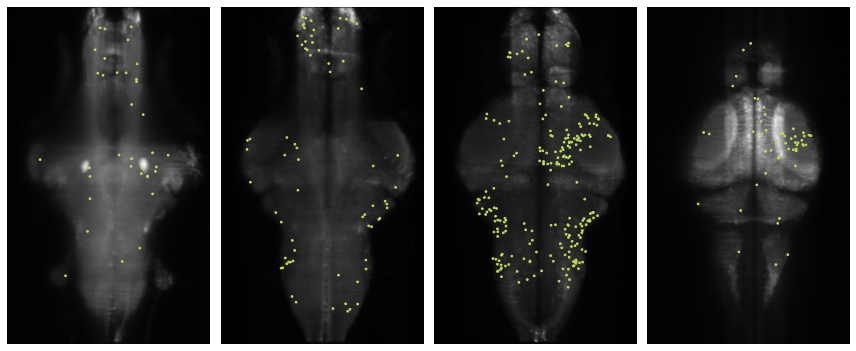

7


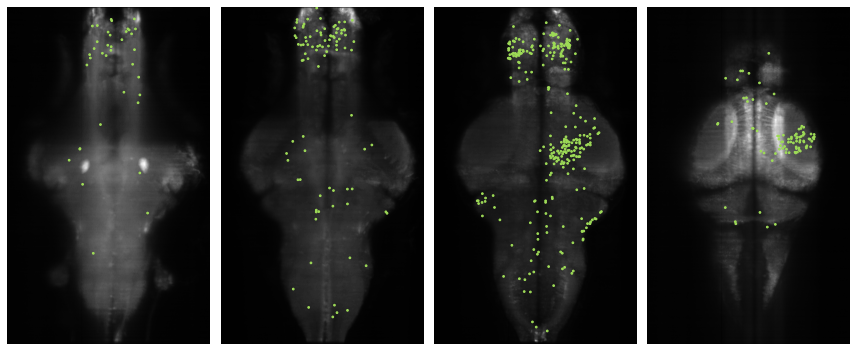

8


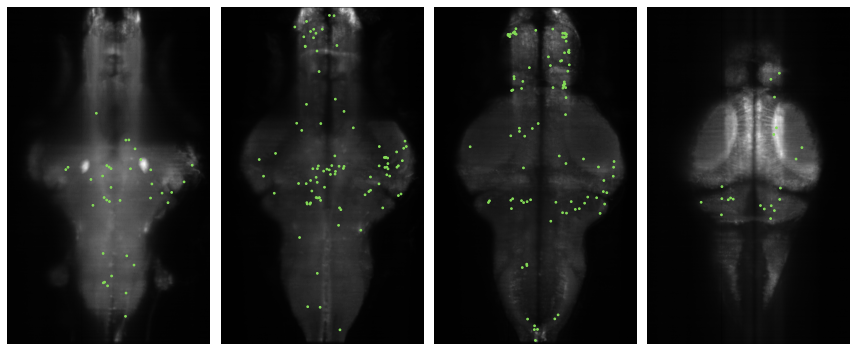

9


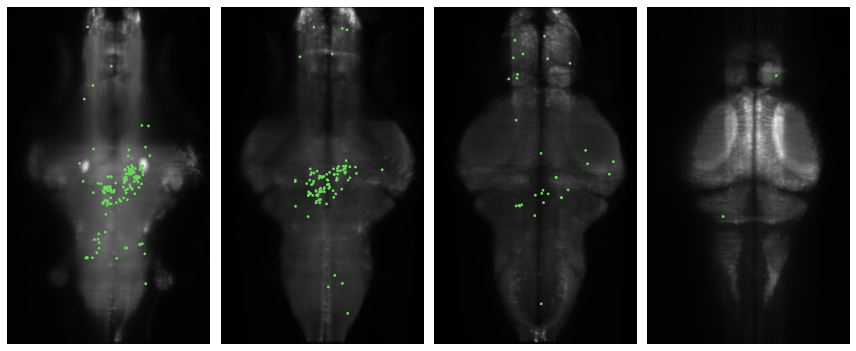

10


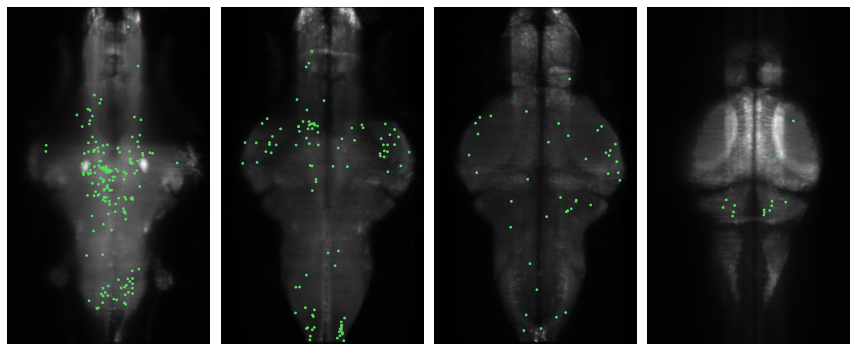

11


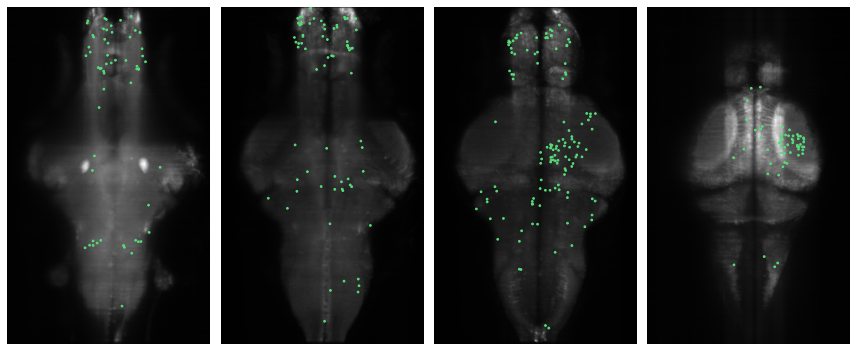

12


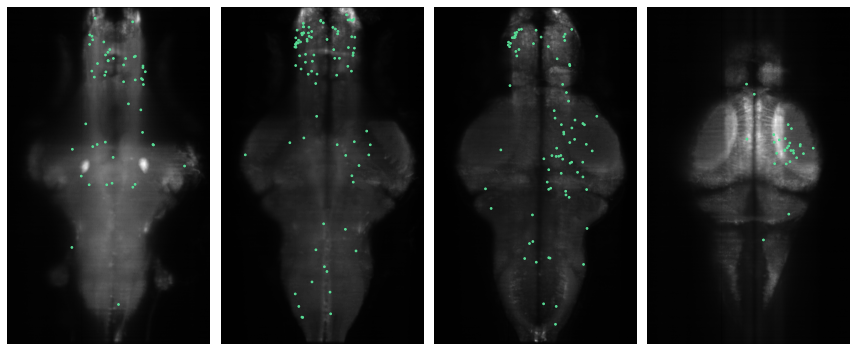

13


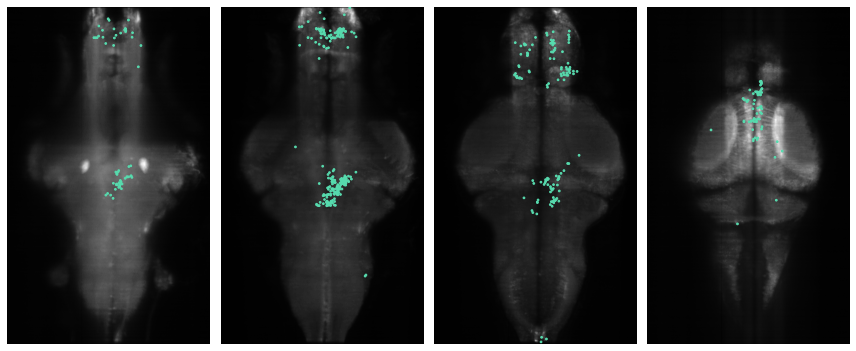

14


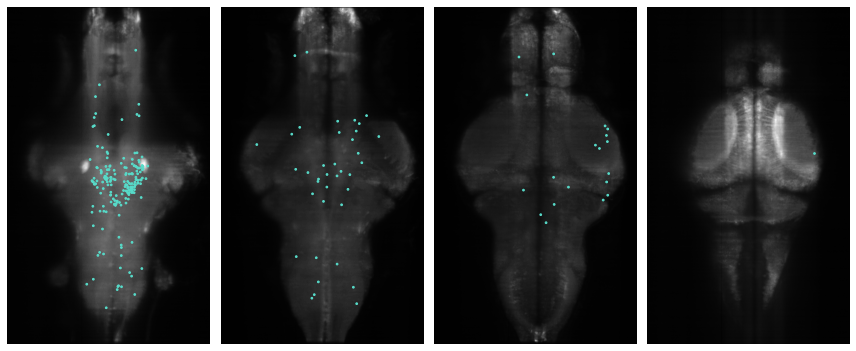

15


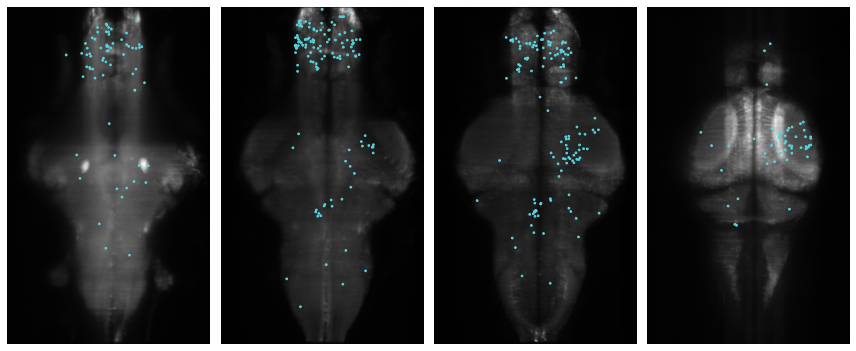

16


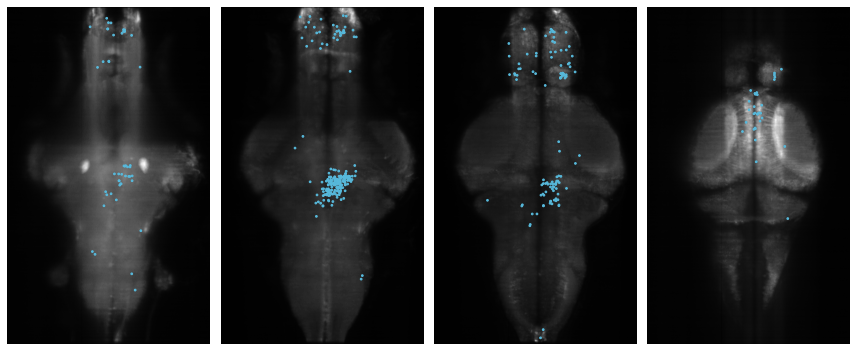

17


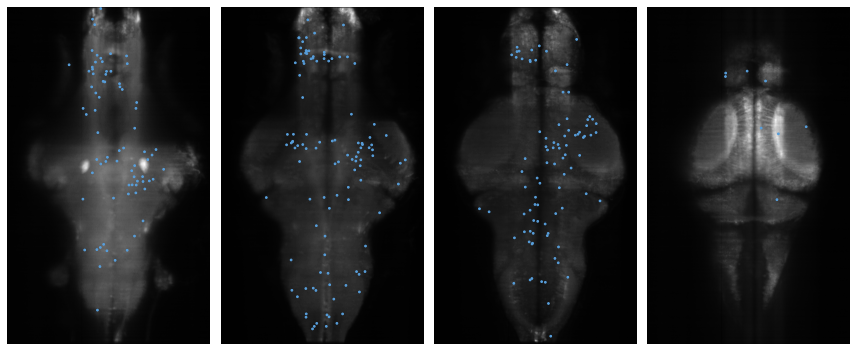

18


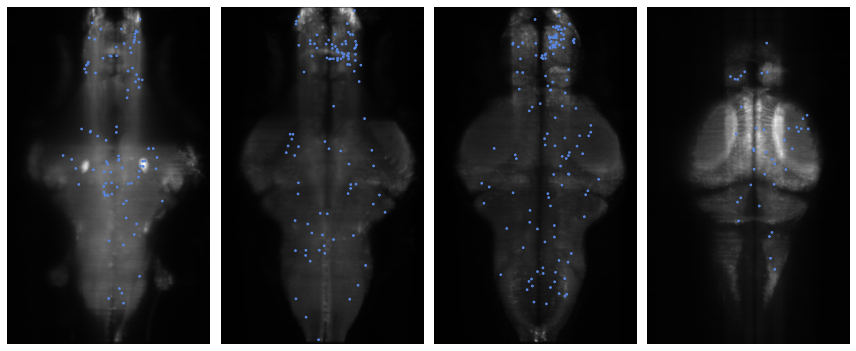

19


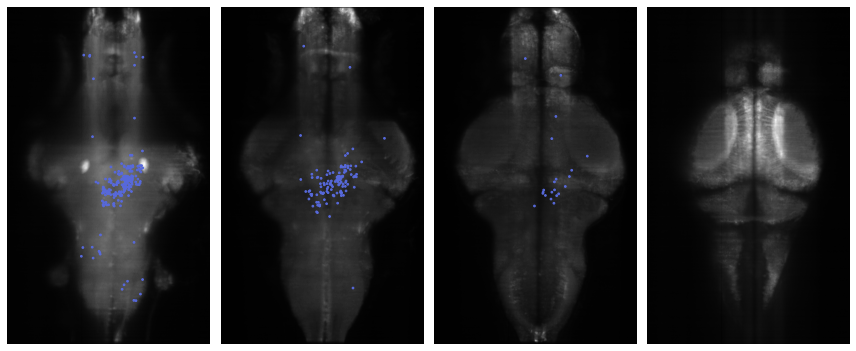

20


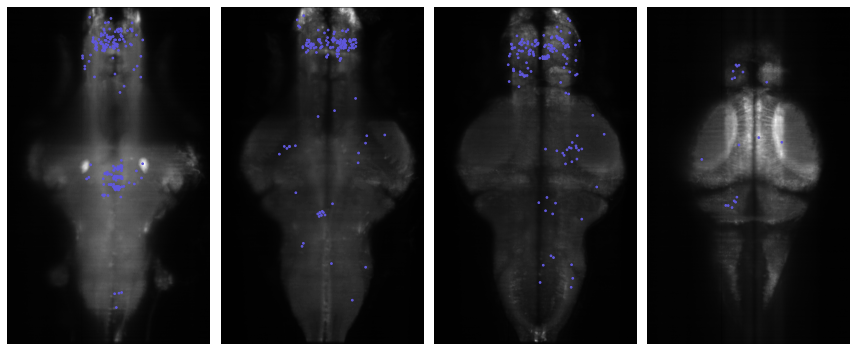

21


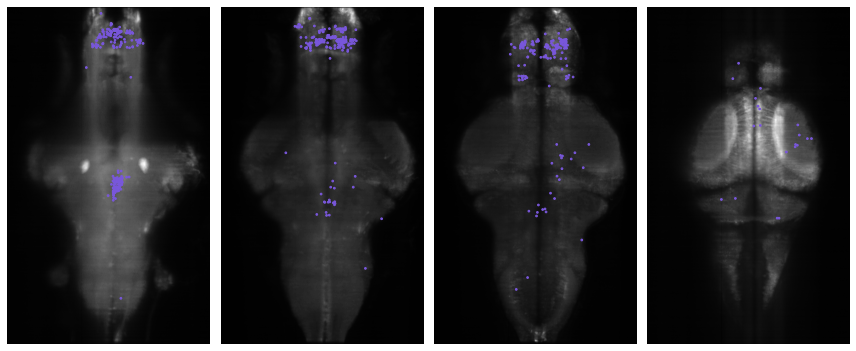

22


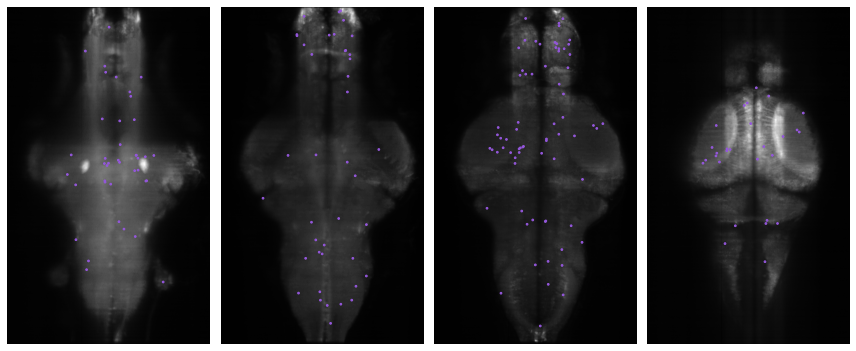

23


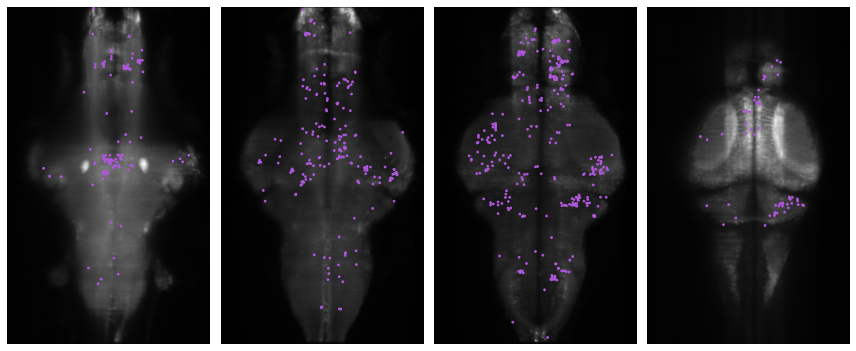

24


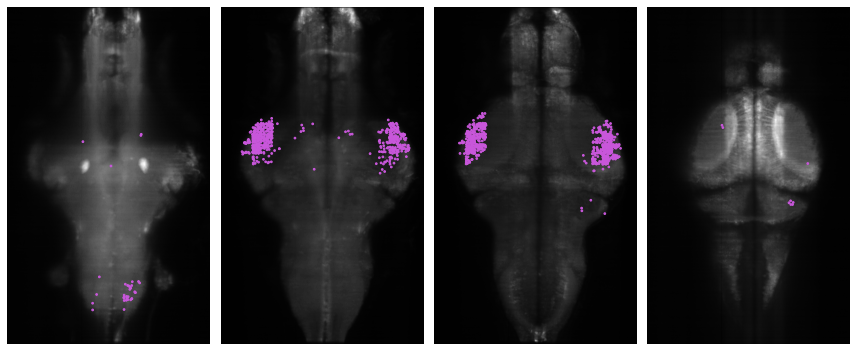

25


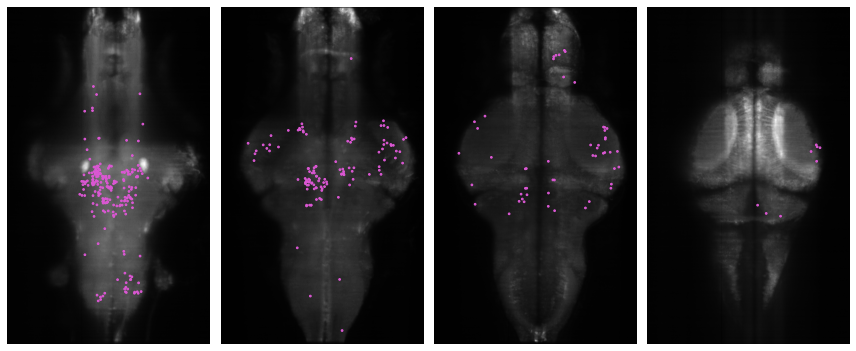

26


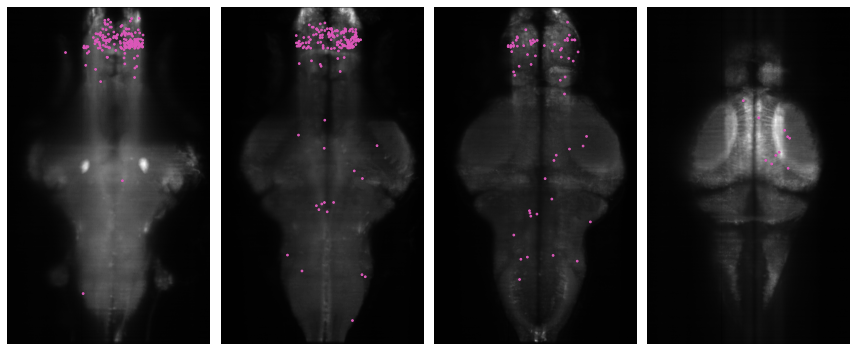

27


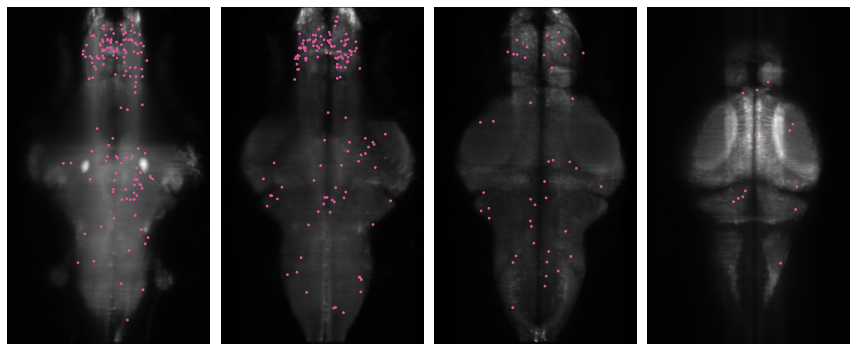

28


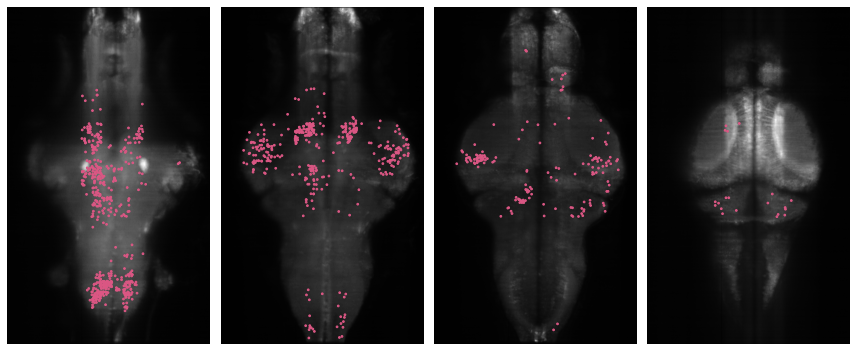

29


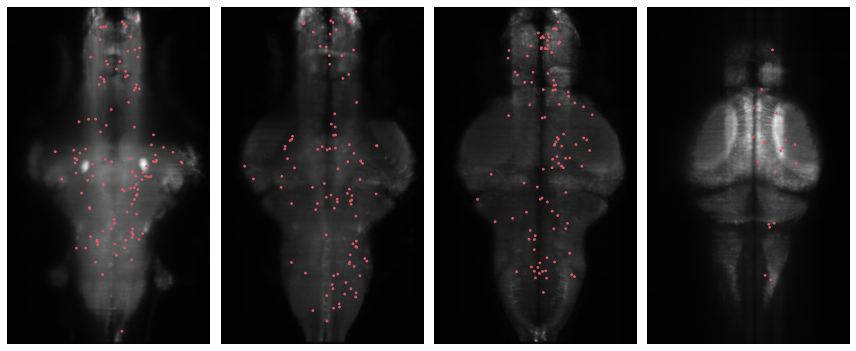

In [10]:
m_clusters = len(np.unique(mpulse_labels_))
my_cmap = ListedColormap(sns.color_palette("hls", m_clusters).as_hex())
vmax = m_clusters
A_center_ = A_center[mpulse_]
z_step = 5
A_center_[:, 0] = A_center_[:, 0]*z_step
ranges_ = [(0, 13), (13, 19), (19, 25), (25, 31)]


for m in range(m_clusters):
    print(m)
    fig, ax = plt.subplots(1, len(ranges_), figsize=(12, 6))
    ax = ax.flatten()
    for n_layer in range(len(ranges_)):
        min_, max_ = ranges_[n_layer]
        ax[n_layer].imshow(brain_map[min_:max_].max(0).T, cmap='gray')
        layer_ = (A_center_[:, 0]>=min_*z_step) & (A_center_[:, 0]<max_*z_step)
        idx_ = layer_ & (mpulse_labels_==m) # & (db_labels>=0)
        ax[n_layer].scatter(A_center_[idx_, 1], A_center_[idx_, 2], c=mpulse_labels_[idx_], cmap=my_cmap, vmin=0, vmax=vmax, s=3)

    [_.set_axis_off() for _ in ax]
    plt.tight_layout()
    plt.show()

### Finer clustering according to their locations

In [11]:
# from fish_proc.utils.getCameraInfo import getCameraInfo
# dir_root = row['dat_dir']
# cm_info = getCameraInfo(dir_root+'im/')

In [12]:
# z_step_um = float(cm_info['z_step'])
# x_step_um = np.abs(float(cm_info['End_X_um'])-float(cm_info['Start_X_um']))/2048
# z_step = z_step_um/x_step_um

In [13]:
# m_clusters = len(np.unique(labels))
# mpulse_ = arr_.copy()
# mpulse_labels_ = labels.copy()
# A_center_ = A_center[mpulse_]
# z_step = 3
# A_center_[:, 0] = A_center_[:, 0]*z_step
# db_labels = -np.ones(arr_.sum())

# m_ = 0
# for m in range(m_clusters):
#     db = DBSCAN(eps=50, min_samples=5).fit(A_center_[mpulse_labels_==m, 1:])
#     db_labels[mpulse_labels_==m] = db.labels_+m_
#     m_ = m_ + db.labels_.max()+1

In [14]:
# m_clusters = m_
# # my_cmap = ListedColormap(sns.color_palette("hls", m_clusters*2).as_hex())
# fig, ax = plt.subplots(6, brain_map.shape[0]//6+1, figsize=(40, 24))
# ax = ax.flatten()
# size_ = np.ones(num_cells)*10
# A_center_ = A_center[mpulse_]
# for n_layer in range(brain_map.shape[0]):
#     ax[n_layer].imshow(brain_map[n_layer], cmap='gray')
#     layer_ = A_center_[:, 0]==n_layer    
#     idx_ = layer_
#     ax[n_layer].scatter(A_center_[idx_, 2], A_center_[idx_, 1], c=db_labels[idx_], cmap=plt.cm.nipy_spectral, vmin=0, vmax=m_clusters, s=3)
# [_.set_axis_off() for _ in ax]
# plt.tight_layout()
# plt.show()

In [15]:
m_clusters = len(np.unique(labels))
index_start = t_pre+np.arange(0, t_post, 6)
index_peak = t_pre+np.arange(3, t_post, 6)
index_start = index_start[:len(index_peak)]
labels_ = labels.copy()
for m in range(m_clusters):
    trend_ = np.mean(nopulse_resp[arr_][labels==m],axis=0)[:,None]
    trend_ = moving_average(trend_, 5).squeeze()
    resp_ = np.mean(pulse_resp[arr_][labels==m],axis=0)
    resp_ = resp_ - trend_
    resp_low = pd.Series(resp_).rolling(8, center=True, min_periods=1).quantile(.05, interpolation='lower')
    trend_ = moving_average(resp_low, 20).squeeze()
    trend_d = trend_[:5].mean() - trend_[-5:].mean()
    pulse_ = resp_-trend_
    diff = pulse_[12:].max()-pulse_[12:].min()
    # print(trend_d, diff)
    if np.abs(diff/trend_d)>2.5:
        indx = 0
    else:
        pulse_amp = (pulse_[index_peak[4:]] - pulse_[index_start[4:]]).sum()
        _, p_pulse_amp = wilcoxon(pulse_[index_peak] - pulse_[index_start])
        if trend_d<0:
            if (pulse_amp<0) and (p_pulse_amp<0.1):
                indx = 2
            else:
                indx = 1
        else:
            if (pulse_amp>0) and (p_pulse_amp<0.1):
                indx = 3
            else:
                if (np.abs(pulse_amp/trend_d))>1.5:
                    indx = 4
                else:
                    indx = 5
    labels_[labels==m] = indx
#     print(m, np.abs(diff/trend_d), pulse_[index_peak[4:]] - pulse_[index_start[4:]], pulse_amp, p_pulse_amp, trend_d, indx)

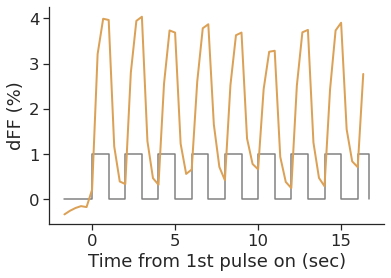

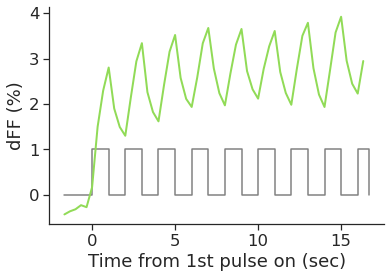

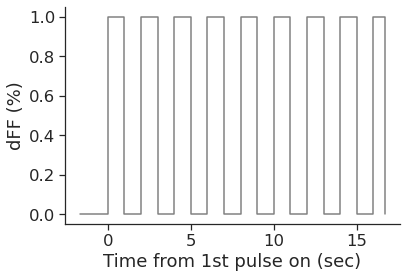

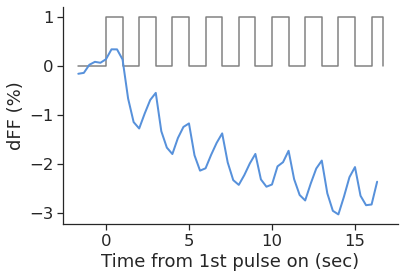

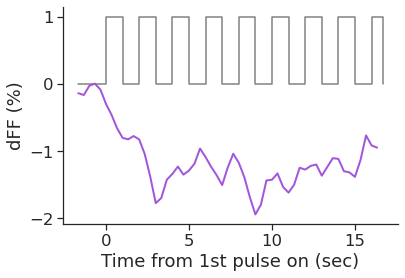

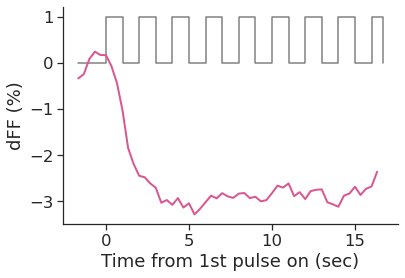

In [16]:
m_clusters = 6#len(np.unique(labels_))
my_cmap = ListedColormap(sns.color_palette("hls", m_clusters*2).as_hex())
pulse_t = np.r_[-t_pre/3, np.arange(t_post/3), t_post/3]
pulse_a = np.r_[0, (np.arange(t_post/3)+1)%2, (np.rint(t_post/3)+1)%2]
for m in range(m_clusters):
    plt.step(pulse_t, pulse_a, c='gray', where='post')
    trend_ = np.mean(nopulse_resp[arr_][labels_==m],axis=0)[:,None]
    trend_ = moving_average(trend_, 5).squeeze()
    resp_ = np.mean(pulse_resp[arr_][labels_==m],axis=0)
    resp_ = resp_ - trend_
    plt.plot(np.arange(-t_pre, t_post)/3, resp_*100, '-', c=my_cmap.colors[m*2+1], lw=2)
    plt.ylabel('dFF (%)')
    plt.xlabel('Time from 1st pulse on (sec)')
    sns.despine()
    plt.savefig(f'pulse_resp_m{m}.svg')
    plt.show()

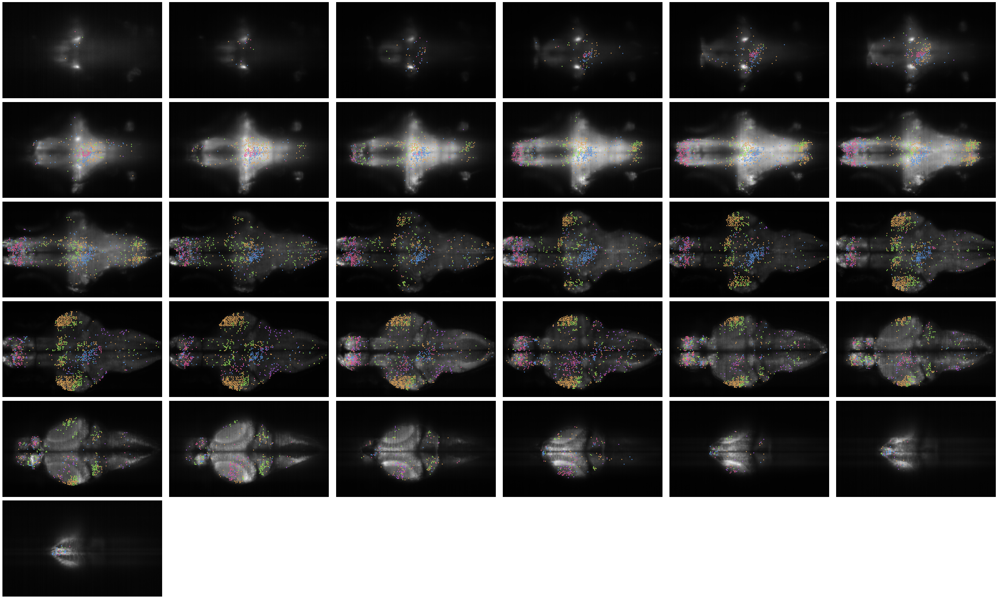

In [17]:
m_clusters = 6#len(np.unique(labels_))
my_cmap = ListedColormap(sns.color_palette("hls", m_clusters*2).as_hex())
mpulse_ = arr_.copy()
mpulse_labels = labels_.copy()
fig, ax = plt.subplots(6, brain_map.shape[0]//6+1, figsize=(40, 24))
ax = ax.flatten()
size_ = np.ones(num_cells)*10
A_center_ = A_center[mpulse_]
for n_layer in range(brain_map.shape[0]):
    ax[n_layer].imshow(brain_map[n_layer], cmap='gray')
    layer_ = A_center_[:, 0]==n_layer    
    idx_ = layer_
    ax[n_layer].scatter(A_center_[idx_, 2], A_center_[idx_, 1], c=labels_[idx_]*2+1, cmap=my_cmap, vmin=0, vmax=m_clusters*2-1, s=3)
[_.set_axis_off() for _ in ax]
plt.tight_layout()
plt.show()

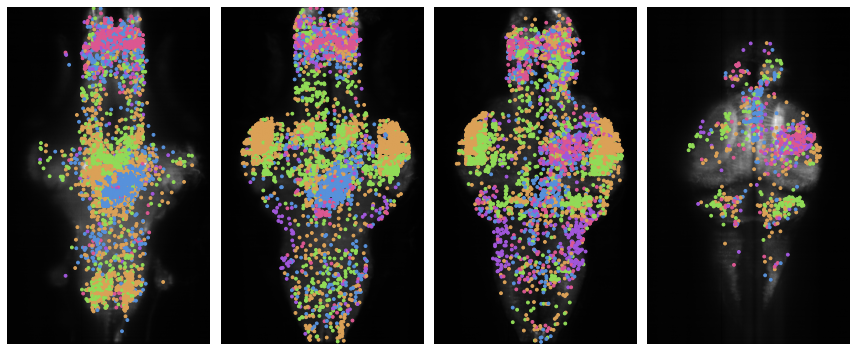

In [18]:
m_clusters = 6 #len(np.unique(labels_))
my_cmap = ListedColormap(sns.color_palette("hls", m_clusters*2).as_hex())
vmax = m_clusters*2-1
# mpulse_ = arr_.copy()
# mpulse_labels = labels_.copy()
A_center_ = A_center[mpulse_]
# ranges_ = [(5, 9), (9, 14), (14, 19), (19, 25), (25, 29)]
ranges_ = [(0, 13), (13, 19), (19, 25), (25, 31)]

fig, ax = plt.subplots(1, len(ranges_), figsize=(12, 6))
ax = ax.flatten()
for n_layer in range(len(ranges_)):
    min_, max_ = ranges_[n_layer]
    ax[n_layer].imshow(brain_map[min_:max_].max(0).T, cmap='gray')
    layer_ = (A_center_[:, 0]>=min_) & (A_center_[:, 0]<max_)
    idx_ = layer_
    ax[n_layer].scatter(A_center_[idx_, 1], A_center_[idx_, 2], c=mpulse_labels[idx_]*2+1, cmap=my_cmap, vmin=0, vmax=vmax, s=8)

[_.set_axis_off() for _ in ax]
plt.tight_layout()
plt.show()

## Motor neurons

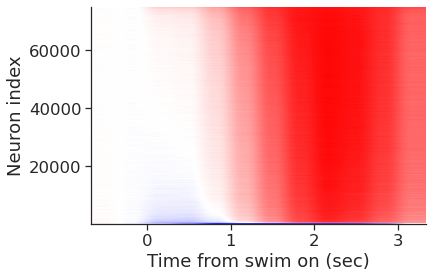

In [19]:
pre_len = 2
swim_len = cell_motor_stats[0][3].shape[0]-pre_len
swim_vec_sel = np.zeros(num_cells).astype('int')
swim_ave_sel_baseline = np.zeros(num_cells).astype('int')
swim_ave_sel_ = np.zeros(num_cells).astype('int')

for n in range(num_cells):
    swim_vec_sel[n] = (cell_motor_stats[n][1][0][pre_len:]<0.05).sum()
    swim_ave_sel_[n] = (cell_motor_stats[n][1][1][pre_len:]<0.05).sum()
    swim_ave_sel_baseline[n] = (cell_motor_stats[n][1][2][pre_len:]>0.05).sum()
    
arr_ = (swim_vec_sel>3) & (swim_ave_sel_>3) & (swim_ave_sel_baseline>=6)
motor_resp = np.zeros((num_cells, swim_len+pre_len))
nomotor_resp = np.zeros((num_cells, swim_len+pre_len))

for n in range(num_cells):
    motor_resp[n] = cell_motor_stats[n][3]
    nomotor_resp[n] = cell_motor_stats[n][4]

motor_resp_norm = motor_resp[arr_]
motor_resp_norm = motor_resp_norm/np.abs(motor_resp_norm).max(axis=-1, keepdims=True)
sort_ord = np.argsort(motor_resp_norm.sum(axis=-1))
plt.imshow(motor_resp_norm[sort_ord[::-1]], aspect='auto', vmax=1, vmin=-1, cmap=plt.cm.bwr, extent=(-pre_len/3, swim_len/3, 1, len(sort_ord)))
plt.ylabel('Neuron index')
plt.xlabel('Time from swim on (sec)')
sns.despine()
plt.show()

In [20]:
motor_neuron = arr_.sum()
labels=np.zeros(motor_neuron)
cell_motor_stats_ = cell_motor_stats[arr_]
for n in range(motor_neuron):
    swim_ave_sel_ = cell_motor_stats_[n][1][1]<0.05
    motor_resp_ = cell_motor_stats_[n][3]
    if (motor_resp_[pre_len+3:]<0).sum()>=4:
        labels[n] =4
        continue
    if (motor_resp_[pre_len:pre_len+3][swim_ave_sel_[pre_len:pre_len+3]]<0).sum()>0:
        labels[n] = 3
        continue
    if (swim_ave_sel_[:pre_len+4].sum()==0):
        labels[n] = 2
        continue
    if (swim_ave_sel_[:pre_len+2].sum()==0):
        labels[n] = 1
        continue

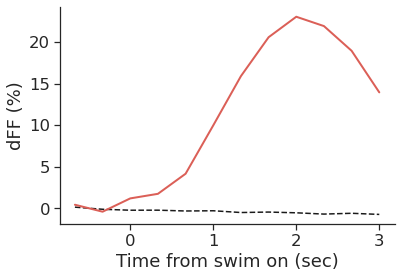

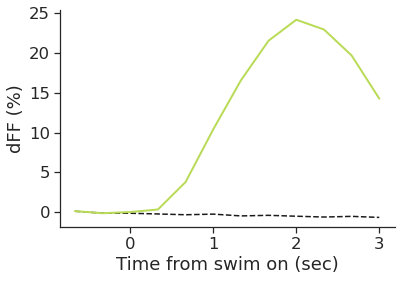

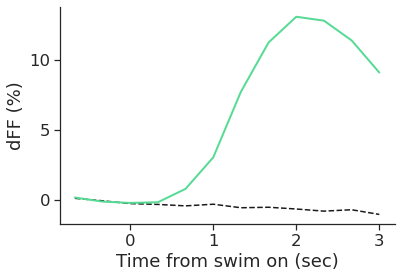

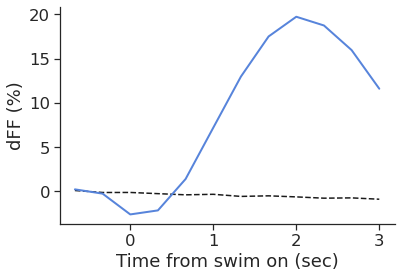

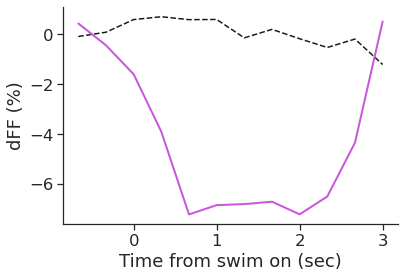

In [21]:
m_clusters = labels.max().astype('int')+1
my_cmap = ListedColormap(sns.color_palette("hls", m_clusters).as_hex())
for m in range(m_clusters):
    plt.plot(np.arange(-pre_len, swim_len)/3, np.mean(nomotor_resp[arr_][labels==m],axis=0)*100, '--k')
    plt.plot(np.arange(-pre_len, swim_len)/3, np.mean(motor_resp[arr_][labels==m],axis=0)*100, '-', c=my_cmap.colors[m], lw=2)
    plt.ylabel('dFF (%)')
    plt.xlabel('Time from swim on (sec)')
    sns.despine()
    plt.show()

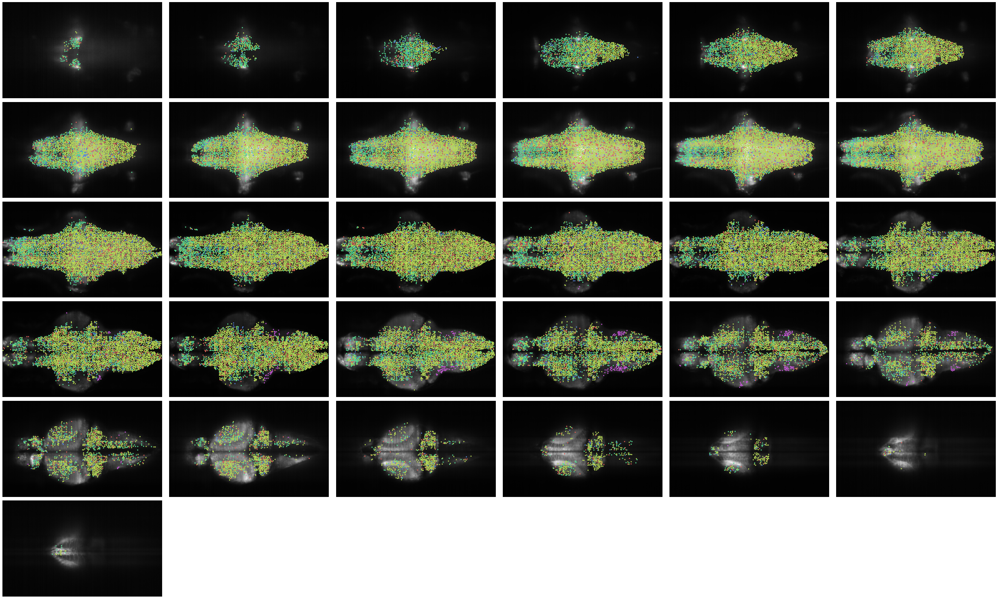

In [22]:
fig, ax = plt.subplots(6, brain_map.shape[0]//6+1, figsize=(40, 24))
ax = ax.flatten()
size_ = np.ones(num_cells)*10
motor_ = arr_.copy()
motor_labels = labels.copy()
A_center_ = A_center[arr_]
for n_layer in range(brain_map.shape[0]):
    ax[n_layer].imshow(brain_map[n_layer], cmap='gray')
    layer_ = A_center_[:, 0]==n_layer    
    idx_ = layer_ # & (labels==4)
    ax[n_layer].scatter(A_center_[idx_, 2], A_center_[idx_, 1], c=labels[idx_], cmap=my_cmap, s=5, vmax=m_clusters-1, vmin=0)
[_.set_axis_off() for _ in ax]
plt.tight_layout()
plt.show()

## Mixed cells

In [23]:
mix_ = mpulse_ & motor_
_mpulse_labels = np.zeros(num_cells)
_mpulse_labels[:] = np.nan
_mpulse_labels[mpulse_] = mpulse_labels
_mpulse_labels_ = np.zeros(num_cells)
_mpulse_labels_[:] = np.nan
_mpulse_labels_[mpulse_] = mpulse_labels_
_motor_labels = np.zeros(num_cells)
_motor_labels[:] = np.nan
_motor_labels[motor_] = motor_labels
# mix_labels = _mpulse_labels * (motor_labels.max()+1) + _motor_labels
# mix_labels = mix_labels[mix_]

# m_clusters = mix_labels[~np.isnan(mix_labels)].max().astype('int')+1
# my_cmap = ListedColormap(sns.color_palette("hls", m_clusters).as_hex())

# fig, ax = plt.subplots(6, brain_map.shape[0]//6+1, figsize=(40, 24))
# ax = ax.flatten()
# size_ = np.ones(num_cells)*10
# A_center_ = A_center[mix_]
# for n_layer in range(brain_map.shape[0]):
#     ax[n_layer].imshow(brain_map[n_layer], cmap='gray')
#     layer_ = A_center_[:, 0]==n_layer    
#     idx_ = layer_
#     ax[n_layer].scatter(A_center_[idx_, 2], A_center_[idx_, 1], c=mix_labels[idx_], cmap=my_cmap, s=5, vmax=m_clusters-1, vmin=0)
# [_.set_axis_off() for _ in ax]
# plt.tight_layout()
# plt.show()

In [24]:
# a_matrix = np.arange((mpulse_labels.max()+1)*(motor_labels.max()+1)).reshape(-1, motor_labels.max().astype(int)+1)

# m_clusters = a_matrix.max().astype(int)+1
# my_cmap = ListedColormap(sns.color_palette("hls", m_clusters*2).as_hex())
# plt.figure(figsize=(6, 4))
# plt.imshow(a_matrix, cmap=my_cmap, aspect='auto', vmin=0, vmax=m_clusters-1)
# plt.axis('off')
# plt.tight_layout()
# plt.show()

## Active vs Passive cells

In [25]:
# for ind, row in df.iterrows():
#     save_root = row['save_dir']+'/'
#     n = []
#     ## active vs passive
#     if os.path.exists(save_root+'cell_no_pulse_ap_stats.npz'):
#         n.append(1)

#     if os.path.exists(save_root+'cell_pulse_ap_stats.npz'):
#         n.append(2)

#     if os.path.exists(save_root+'cell_no_swim_ap_stats.npz'):
#         n.append(3)

#     if os.path.exists(save_root+'cell_pulse_swim_ap_stats.npz'):
#         n.append(4)
#     print(ind, n)

In [26]:
# row = df.iloc[2]
# save_root = row['save_dir']+'/'
# print(row['taskType'])
# print(save_root)

In [27]:
save_root

'/nrs/ahrens/Ziqiang/Jing_Glia_project/Processed_data/20191130/fish00/6dpf_HuC-GC7FF_GU-fwd_fish00_exp05_20191130_194544//'

In [28]:
## active vs passive
if os.path.exists(save_root+'cell_no_pulse_ap_stats_raw.npz'):
    _ = np.load(save_root+'cell_no_pulse_ap_stats_raw.npz', allow_pickle=True)
    cell_no_pulse_ap_stats=_['cell_no_pulse_ap_stats']
    print('cell_no_pulse_ap_stats')

if os.path.exists(save_root+'cell_pulse_ap_stats_raw.npz'):
    _ = np.load(save_root+'cell_pulse_ap_stats_raw.npz', allow_pickle=True)
    cell_pulse_ap_stats=_['cell_pulse_ap_stats']
    print('cell_pulse_ap_stats')

if os.path.exists(save_root+'cell_no_swim_ap_stats.npz'):
    _ = np.load(save_root+'cell_no_swim_ap_stats.npz', allow_pickle=True)
    cell_no_swim_ap_stats=_['cell_no_swim_ap_stats']
    print('cell_no_swim_ap_stats')

if os.path.exists(save_root+'cell_pulse_swim_ap_stats.npz'):
    _ = np.load(save_root+'cell_pulse_swim_ap_stats.npz', allow_pickle=True)
    cell_pulse_swim_ap_stats=_['cell_pulse_swim_ap_stats']
    print('cell_pulse_swim_ap_stats')

cell_no_pulse_ap_stats
cell_pulse_ap_stats


In [29]:
dat_stats = cell_no_pulse_ap_stats
t_pre = 5
t_post = 120

pulse_active_vec_sel = np.zeros(num_cells).astype('int')

for n in range(num_cells):
    pulse_active_vec_sel[n] = (dat_stats[n][0][0][3:]<0.05).sum()
    
active_resp = np.zeros((num_cells, t_pre+t_post))
passive_resp = np.zeros((num_cells, t_pre+t_post))

for n in range(num_cells):
    active_resp[n] = dat_stats[n][1]
    passive_resp[n] = dat_stats[n][2]

active_resp_baseline = active_resp.copy()
passive_resp_baseline = passive_resp.copy()

In [30]:
np.unique(pulse_active_vec_sel, return_counts=True)

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
        34, 35, 36, 37, 38, 39, 40, 42, 45, 47, 49, 52, 61, 78]),
 array([  282,  1567,  4550,  8897, 14097, 17581, 18770, 16928, 14018,
        10295,  7133,  4387,  2600,  1601,   928,   514,   276,   193,
          119,    69,    43,    16,    21,    13,    15,    18,     9,
            7,     8,     4,     4,     3,     1,     6,     3,     1,
            4,     1,     1,     2,     1,     1,     1,     1,     2,
            1,     1,     1]))

In [31]:
arr_ = pulse_active_vec_sel>=12
arr_.sum(), arr_.mean()

(6489, 0.05191449189561099)

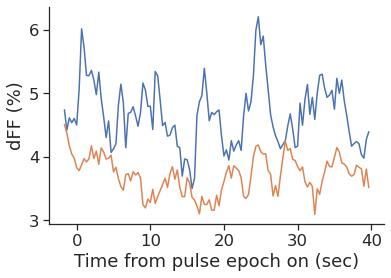

In [32]:
plt.plot(np.arange(-t_pre, t_post)/3,active_resp[arr_ & mpulse_].mean(axis=0)*100)
plt.plot(np.arange(-t_pre, t_post)/3,passive_resp[arr_ & mpulse_].mean(axis=0)*100)
plt.ylabel('dFF (%)')
plt.xlabel('Time from pulse epoch on (sec)')
sns.despine()
plt.show()

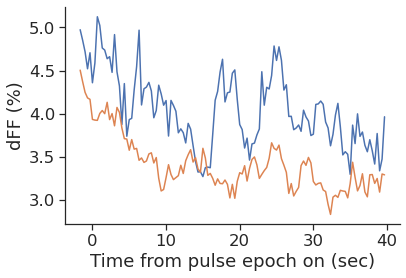

In [33]:
plt.plot(np.arange(-t_pre, t_post)/3,active_resp[arr_ & motor_].mean(axis=0)*100)
plt.plot(np.arange(-t_pre, t_post)/3,passive_resp[arr_ & motor_].mean(axis=0)*100)
plt.ylabel('dFF (%)')
plt.xlabel('Time from pulse epoch on (sec)')
sns.despine()
plt.show()

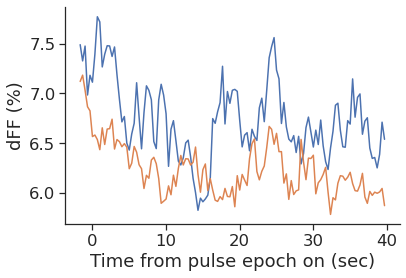

In [34]:
plt.plot(np.arange(-t_pre, t_post)/3,active_resp[arr_ & ~motor_ & ~mpulse_].mean(axis=0)*100)
plt.plot(np.arange(-t_pre, t_post)/3,passive_resp[arr_ & ~motor_ & ~mpulse_].mean(axis=0)*100)
plt.ylabel('dFF (%)')
plt.xlabel('Time from pulse epoch on (sec)')
sns.despine()
plt.show()

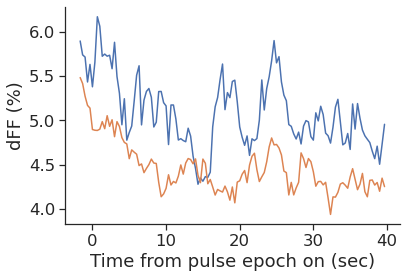

In [35]:
plt.plot(np.arange(-t_pre, t_post)/3,active_resp[arr_].mean(axis=0)*100)
plt.plot(np.arange(-t_pre, t_post)/3,passive_resp[arr_].mean(axis=0)*100)
plt.ylabel('dFF (%)')
plt.xlabel('Time from pulse epoch on (sec)')
sns.despine()
plt.show()

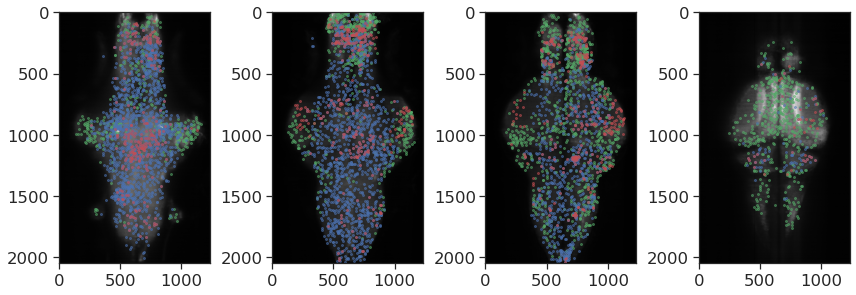

In [36]:
arr_ = pulse_active_vec_sel>=12
ranges_ = [(0, 13), (13, 19), (19, 25), (25, 31)]

fig, ax = plt.subplots(1, len(ranges_), figsize=(12, 6))
ax = ax.flatten()
for n_layer in range(len(ranges_)):
    min_, max_ = ranges_[n_layer]
    ax[n_layer].imshow(brain_map[min_:max_].max(0).T, cmap='gray')

A_center_ = A_center[arr_ & ~motor_ & ~mpulse_]
for n_layer in range(len(ranges_)):
    min_, max_ = ranges_[n_layer]
    layer_ = (A_center_[:, 0]>=min_) & (A_center_[:, 0]<max_)
    idx_ = layer_
    ax[n_layer].plot(A_center_[idx_, 1], A_center_[idx_, 2], '.g', ms=4, alpha=0.5)
    
A_center_ = A_center[arr_ & motor_]
for n_layer in range(len(ranges_)):
    min_, max_ = ranges_[n_layer]
    layer_ = (A_center_[:, 0]>=min_) & (A_center_[:, 0]<max_)
    idx_ = layer_
    ax[n_layer].plot(A_center_[idx_, 1], A_center_[idx_, 2], '.b', ms=4, alpha=0.5)


A_center_ = A_center[arr_ & mpulse_]
for n_layer in range(len(ranges_)):
    min_, max_ = ranges_[n_layer]
    layer_ = (A_center_[:, 0]>=min_) & (A_center_[:, 0]<max_)
    idx_ = layer_
    ax[n_layer].plot(A_center_[idx_, 1], A_center_[idx_, 2], '.r', ms=4, alpha=0.5)


# [_.set_axis_off() for _ in ax]
plt.tight_layout()
plt.show()

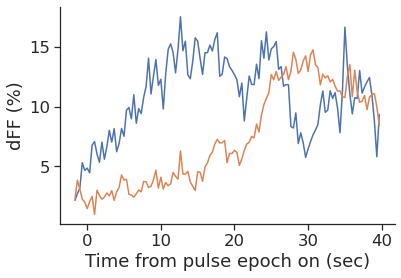

In [37]:
arr_ = pulse_active_vec_sel>14
layer_ = (A_center[:, 0]>=19) & (A_center[:, 0]<25) & (A_center[:, 2]<500) & (A_center[:, 2]>400)
plt.plot(np.arange(-t_pre, t_post)/3,active_resp[arr_ & mpulse_ & layer_].mean(axis=0)*100)
plt.plot(np.arange(-t_pre, t_post)/3,passive_resp[arr_ & mpulse_ & layer_].mean(axis=0)*100)
plt.ylabel('dFF (%)')
plt.xlabel('Time from pulse epoch on (sec)')
sns.despine()
plt.savefig('HB_example.svg')
plt.show()

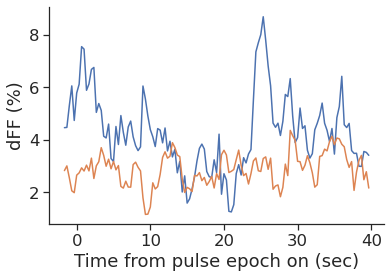

In [38]:
arr_ = pulse_active_vec_sel>14
layer_ = (A_center[:, 0]>=13) & (A_center[:, 0]<19) & (A_center[:, 2]<400) & (A_center[:, 2]>200)
plt.plot(np.arange(-t_pre, t_post)/3,active_resp[arr_ & mpulse_ & layer_].mean(axis=0)*100)
plt.plot(np.arange(-t_pre, t_post)/3,passive_resp[arr_ & mpulse_ & layer_].mean(axis=0)*100)
plt.ylabel('dFF (%)')
plt.xlabel('Time from pulse epoch on (sec)')
sns.despine()
plt.show()

In [39]:
A_center[:, 1].max()

1188.4181009163533

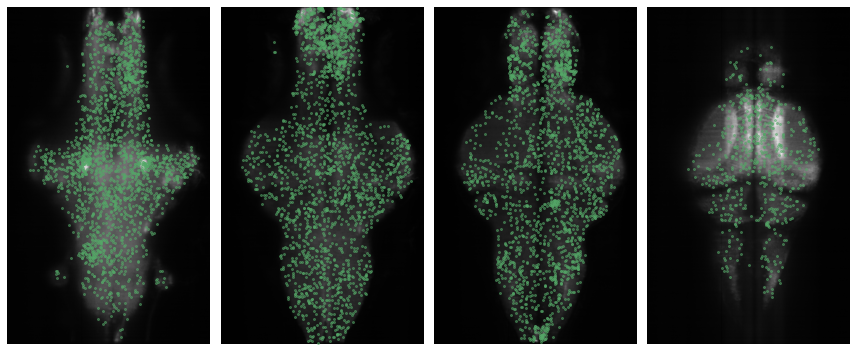

In [40]:
arr_ = pulse_active_vec_sel>=12
ranges_ = [(0, 13), (13, 19), (19, 25), (25, 31)]

fig, ax = plt.subplots(1, len(ranges_), figsize=(12, 6))
ax = ax.flatten()
for n_layer in range(len(ranges_)):
    min_, max_ = ranges_[n_layer]
    ax[n_layer].imshow(brain_map[min_:max_].max(0).T, cmap='gray')

A_center_ = A_center[arr_]
for n_layer in range(len(ranges_)):
    min_, max_ = ranges_[n_layer]
    layer_ = (A_center_[:, 0]>=min_) & (A_center_[:, 0]<max_)
    idx_ = layer_
    ax[n_layer].plot(A_center_[idx_, 1], A_center_[idx_, 2], '.g', ms=4, alpha=0.5)

[_.set_axis_off() for _ in ax]
plt.tight_layout()
plt.show()

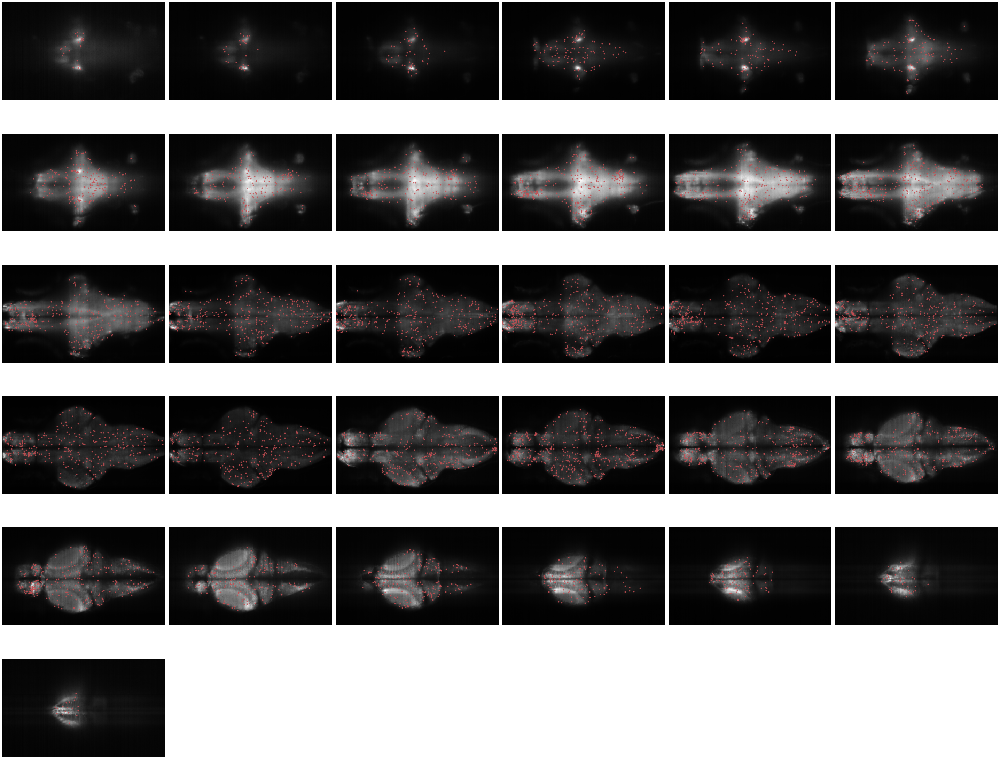

In [41]:
fig, ax = plt.subplots(6, brain_map.shape[0]//6+1, figsize=(40, 32))
ax = ax.flatten()
for n_layer in range(brain_map.shape[0]):
    ax[n_layer].imshow(brain_map[n_layer], cmap='gray')
    layer_ = A_center[:, 0]==n_layer    
    ax[n_layer].plot(A_center[arr_ & layer_, 2], A_center[arr_ & layer_, 1], '.r', alpha=0.8)
    
[_.set_axis_off() for _ in ax]
plt.tight_layout()
plt.show()

In [53]:
dat_stats = cell_pulse_ap_stats
t_pre = 5
t_post = 120

pulse_active_vec_sel = np.zeros(num_cells).astype('int')

for n in range(num_cells):
    pulse_active_vec_sel[n] = (dat_stats[n][3][0][t_pre:t_pre+50]<0.05).sum()
    
active_resp = np.zeros((num_cells, t_pre+t_post))
passive_resp = np.zeros((num_cells, t_pre+t_post))

for n in range(num_cells):
    active_resp[n] = dat_stats[n][1]
    passive_resp[n] = dat_stats[n][2]

active_resp_baseline_ =  moving_average(active_resp_baseline, 20, axis=1)
passive_resp_baseline_ =  moving_average(passive_resp_baseline, 20, axis=1)

active_resp -= active_resp_baseline_
passive_resp -= passive_resp_baseline_

In [54]:
# np.unique(pulse_active_vec_sel, return_counts=True), np.unique(_mpulse_labels, return_counts=True)

In [55]:
np.unique(pulse_active_vec_sel, return_counts=True)

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
        17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
        34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50]),
 array([   5,   12,   13,   17,   28,   53,   55,   69,  114,  133,  147,
         209,  267,  367,  427,  609,  727,  787, 1082, 1202, 1516, 1701,
        1970, 2375, 2688, 3145, 3428, 3782, 4185, 4912, 4926, 5337, 5508,
        5828, 5868, 5918, 5896, 5878, 5780, 5452, 5134, 4983, 4386, 3903,
        3454, 2832, 2365, 1975, 1534, 1118,  894]))

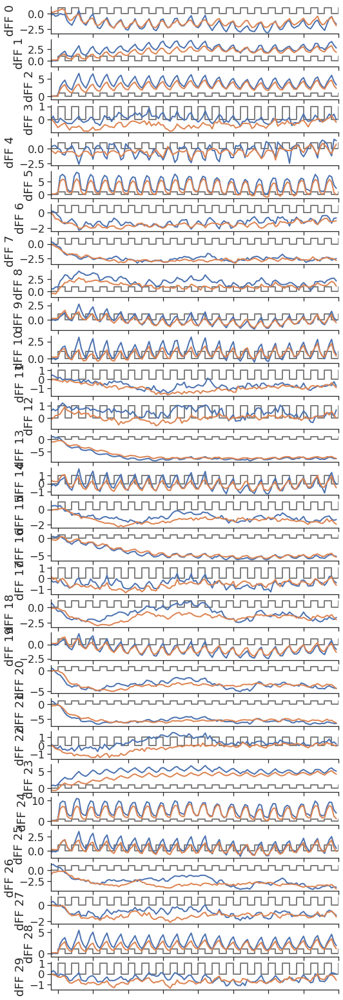

In [61]:
arr_ = pulse_active_vec_sel>30
pulse_t = np.r_[-t_pre/3, np.arange(t_post/3), t_post/3]
pulse_a = np.r_[0, (np.arange(t_post/3)+1)%2, (np.rint(t_post/3)+1)%2]
m_max = int(mpulse_labels_.max())+1
fig, ax = plt.subplots(m_max, 1, figsize=(8, 28))
ax = ax.flatten()

for m in range(m_max):
    mean_act = active_resp[(_mpulse_labels_==m) & arr_].mean(axis=0)
    mean_pass = passive_resp[(_mpulse_labels_==m) & arr_].mean(axis=0)
    off_ = (mean_act[:t_pre].mean()+mean_pass[:t_pre].mean())/2
    mean_act -= off_
    mean_pass -= off_ 
    ax[m].step(pulse_t, pulse_a, c='gray', where='post', lw=2)
    ax[m].plot(np.arange(-t_pre, t_post)/3,mean_act*100, lw=2)
    ax[m].plot(np.arange(-t_pre, t_post)/3,mean_pass*100, lw=2)
    ax[m].set_xlim([-1, 40])
    ax[m].set_ylabel(f'dFF {m}')
    ax[m].set_xticklabels([])
    # ax[m].set_xlabel('Time from pulse epoch on (sec)')
    sns.despine()
plt.savefig('example_state_modulated_sensory.pdf')
plt.show()

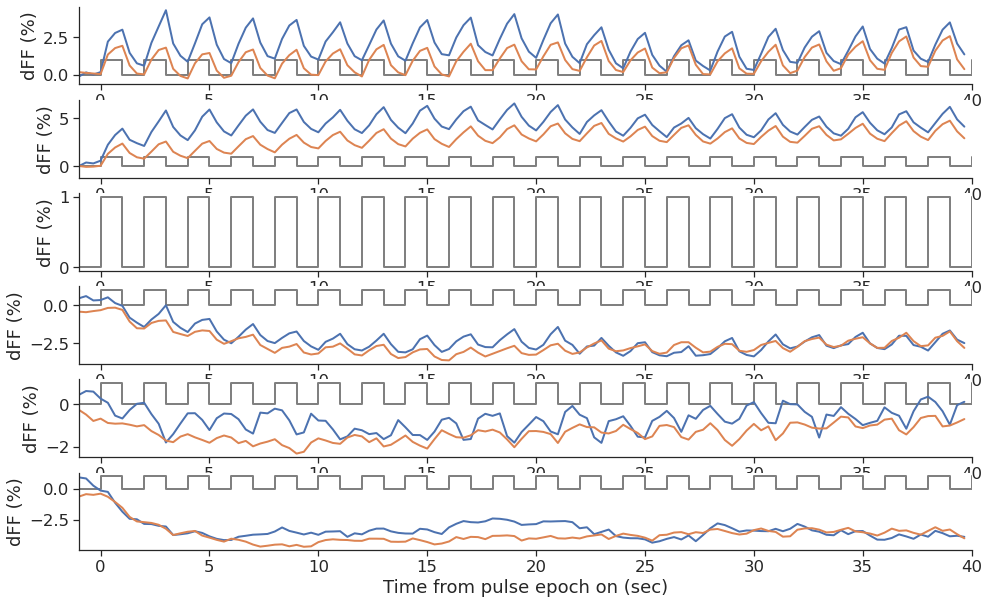

In [47]:
arr_ = pulse_active_vec_sel>40
pulse_t = np.r_[-t_pre/3, np.arange(t_post/3), t_post/3]
pulse_a = np.r_[0, (np.arange(t_post/3)+1)%2, (np.rint(t_post/3)+1)%2]
m_max = int(mpulse_labels.max())+1
fig, ax = plt.subplots(m_max, 1, figsize=(16, 10))
ax = ax.flatten()

for m in range(m_max):
    mean_act = active_resp[(_mpulse_labels==m) & arr_].mean(axis=0)
    mean_pass = passive_resp[(_mpulse_labels==m) & arr_].mean(axis=0)
    off_ = (mean_act[:t_pre].mean()+mean_pass[:t_pre].mean())/2
    mean_act -= off_
    mean_pass -= off_ 
    ax[m].step(pulse_t, pulse_a, c='gray', where='post', lw=2)
    ax[m].plot(np.arange(-t_pre, t_post)/3,mean_act*100, lw=2)
    ax[m].plot(np.arange(-t_pre, t_post)/3,mean_pass*100, lw=2)
    ax[m].set_xlim([-1, 40])
    ax[m].set_ylabel('dFF (%)')
    ax[m].set_xlabel('Time from pulse epoch on (sec)')
    sns.despine()
plt.savefig('example_state_modulated_sensory_less_cluster.svg')
plt.show()

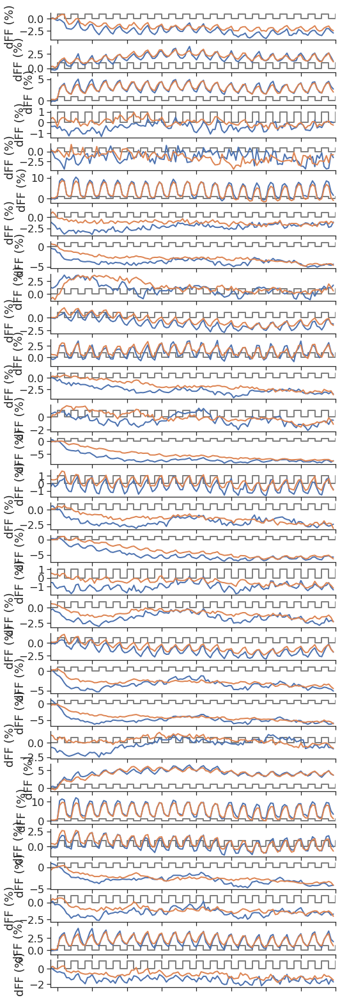

In [62]:
arr_ = pulse_active_vec_sel<30
pulse_t = np.r_[-t_pre/3, np.arange(t_post/3), t_post/3]
pulse_a = np.r_[0, (np.arange(t_post/3)+1)%2, (np.rint(t_post/3)+1)%2]
m_max = int(mpulse_labels_.max())+1
fig, ax = plt.subplots(m_max, 1, figsize=(8, 28))
ax = ax.flatten()

for m in range(m_max):
    mean_act = active_resp[(_mpulse_labels_==m) & arr_].mean(axis=0)
    mean_pass = passive_resp[(_mpulse_labels_==m) & arr_].mean(axis=0)
    off_ = (mean_act[:t_pre].mean()+mean_pass[:t_pre].mean())/2
    mean_act -= off_
    mean_pass -= off_ 
    ax[m].step(pulse_t, pulse_a, c='gray', where='post', lw=2)
    ax[m].plot(np.arange(-t_pre, t_post)/3,mean_act*100, lw=2, c='C0')
    ax[m].plot(np.arange(-t_pre, t_post)/3,mean_pass*100, lw=2, c='C1')
    ax[m].set_xlim([-1, 40])
    ax[m].set_ylabel('dFF (%)')
    ax[m].set_xticklabels([])
    # ax[m].set_xlabel('Time from pulse epoch on (sec)')
    sns.despine()
plt.savefig('example_state_no_modulated_sensory_cluster.pdf')
plt.show()

In [67]:
arr_ = pulse_active_vec_sel<30
for m in range(mpulse_labels_.max()):
    print(np.sum(arr_[mpulse_] & (mpulse_labels_==m))/np.sum(mpulse_labels_==m))

0.1850828729281768
0.26638176638176636
0.3060374739764053
0.275
0.013422818791946308
0.5680473372781065
0.18798955613577023
0.20857699805068225
0.3319838056680162
0.2890625
0.22580645161290322
0.2672955974842767
0.3617886178861789
0.26272912423625255
0.21686746987951808
0.23529411764705882
0.41935483870967744
0.3487544483985765
0.23705722070844687
0.2122905027932961
0.22593320235756384
0.28114478114478114
0.2777777777777778
0.3103448275862069
0.5447698744769874
0.2518891687657431
0.4019138755980861
0.37425149700598803
0.23939679547596607


1798
None
924
None
817
None
162
None
642
None


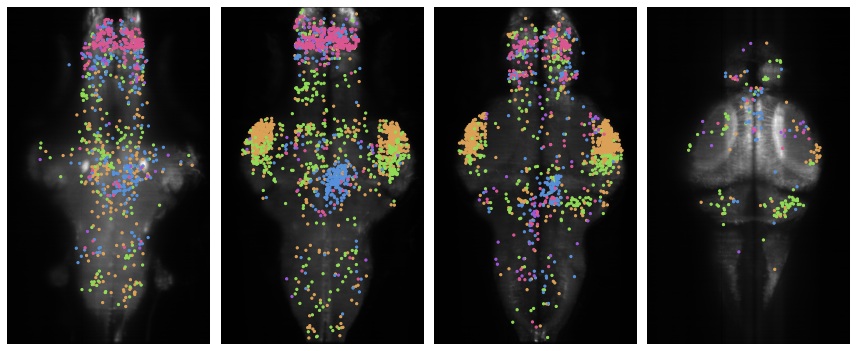

In [63]:
arr_ = pulse_active_vec_sel<30
m_clusters = 6 #len(np.unique(labels_))
my_cmap = ListedColormap(sns.color_palette("hls", m_clusters*2).as_hex())
A_center_ = A_center[mpulse_]
z_step = 1
A_center_[:, 0] = A_center_[:, 0]*z_step
ranges_ = [(0, 13), (13, 19), (19, 25), (25, 31)]

fig, ax = plt.subplots(1, len(ranges_), figsize=(12, 6))
ax = ax.flatten()
for n_layer in range(len(ranges_)):
    min_, max_ = ranges_[n_layer]
    ax[n_layer].imshow(brain_map[min_:max_].max(0).T, cmap='gray')

for m in range(6):
    if (mpulse_labels==m).sum()==0:
        continue
    print(print(np.sum(arr_[mpulse_] & (mpulse_labels==m))))
#     db = DBSCAN(eps=30, min_samples=10).fit(A_center_[mpulse_labels==m])
#     db_labels = -np.ones(mpulse_.sum())
#     db_labels[mpulse_labels==m] = db.labels_
    for n_layer in range(len(ranges_)):
        min_, max_ = ranges_[n_layer]
        layer_ = (A_center_[:, 0]>=min_*z_step) & (A_center_[:, 0]<max_*z_step)
        idx_ = layer_  & arr_[mpulse_] & (mpulse_labels==m) #& (db_labels>=0)
        ax[n_layer].scatter(A_center_[idx_, 1], A_center_[idx_, 2], c=m*2+np.ones(idx_.sum()), cmap=my_cmap, vmin=0, vmax=m_clusters*2-1, s=5)
[_.set_axis_off() for _ in ax]
plt.tight_layout()
plt.show()

2920
2028
1905
714
1625


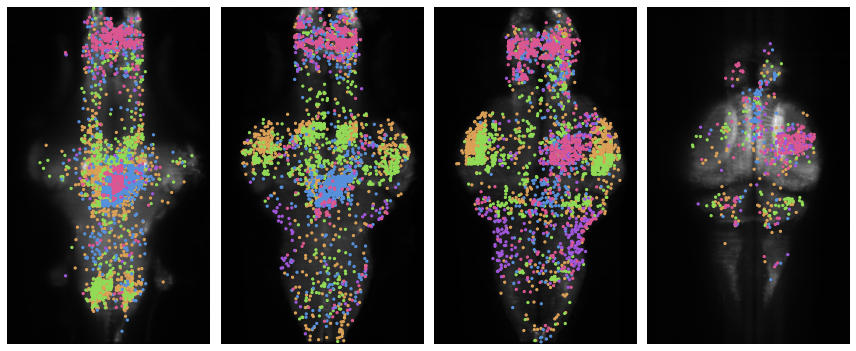

In [64]:
arr_ = pulse_active_vec_sel>30
m_clusters = 6 #len(np.unique(labels_))
my_cmap = ListedColormap(sns.color_palette("hls", m_clusters*2).as_hex())
A_center_ = A_center[mpulse_]
z_step = 1
A_center_[:, 0] = A_center_[:, 0]*z_step
ranges_ = [(0, 13), (13, 19), (19, 25), (25, 31)]

fig, ax = plt.subplots(1, len(ranges_), figsize=(12, 6))
ax = ax.flatten()
for n_layer in range(len(ranges_)):
    min_, max_ = ranges_[n_layer]
    ax[n_layer].imshow(brain_map[min_:max_].max(0).T, cmap='gray')

for m in range(6):
    if (mpulse_labels==m).sum()==0:
        continue
    print(np.sum(arr_[mpulse_] & (mpulse_labels==m)))
#     db = DBSCAN(eps=30, min_samples=10).fit(A_center_[mpulse_labels==m])
#     db_labels = -np.ones(mpulse_.sum())
#     db_labels[mpulse_labels==m] = db.labels_
    for n_layer in range(len(ranges_)):
        min_, max_ = ranges_[n_layer]
        layer_ = (A_center_[:, 0]>=min_*z_step) & (A_center_[:, 0]<max_*z_step)
        idx_ = layer_  & arr_[mpulse_] & (mpulse_labels==m) #& (db_labels>=0)
        ax[n_layer].scatter(A_center_[idx_, 1], A_center_[idx_, 2], c=m*2+np.ones(idx_.sum()), cmap=my_cmap, vmin=0, vmax=m_clusters*2-1, s=5)
[_.set_axis_off() for _ in ax]
plt.tight_layout()
plt.show()

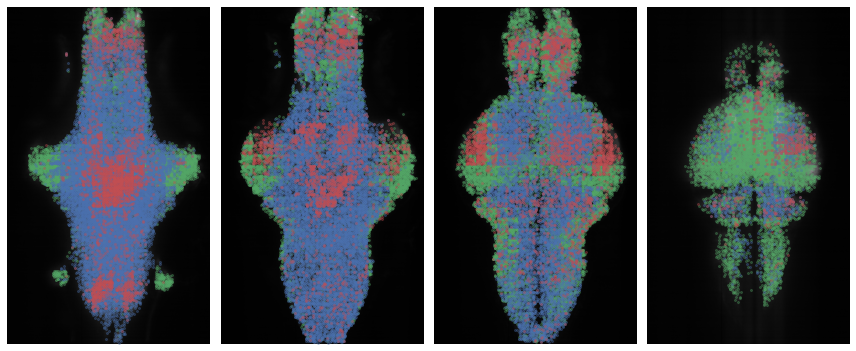

In [51]:
arr_ = pulse_active_vec_sel>30
ranges_ = [(0, 13), (13, 19), (19, 25), (25, 31)]

fig, ax = plt.subplots(1, len(ranges_), figsize=(12, 6))
ax = ax.flatten()
for n_layer in range(len(ranges_)):
    min_, max_ = ranges_[n_layer]
    ax[n_layer].imshow(brain_map[min_:max_].max(0).T, cmap='gray')

A_center_ = A_center[arr_ & (~motor_) & (~mpulse_)]
for n_layer in range(len(ranges_)):
    min_, max_ = ranges_[n_layer]
    layer_ = (A_center_[:, 0]>=min_) & (A_center_[:, 0]<max_)
    idx_ = layer_
    ax[n_layer].plot(A_center_[idx_, 1], A_center_[idx_, 2], '.g', ms=4, alpha=0.3)
    
A_center_ = A_center[arr_ & motor_]
for n_layer in range(len(ranges_)):
    min_, max_ = ranges_[n_layer]
    layer_ = (A_center_[:, 0]>=min_) & (A_center_[:, 0]<max_)
    idx_ = layer_
    ax[n_layer].plot(A_center_[idx_, 1], A_center_[idx_, 2], '.b', ms=4, alpha=0.3)


A_center_ = A_center[arr_ & mpulse_]
for n_layer in range(len(ranges_)):
    min_, max_ = ranges_[n_layer]
    layer_ = (A_center_[:, 0]>=min_) & (A_center_[:, 0]<max_)
    idx_ = layer_
    ax[n_layer].plot(A_center_[idx_, 1], A_center_[idx_, 2], '.r', ms=4, alpha=0.3)


[_.set_axis_off() for _ in ax]
plt.tight_layout()
plt.show()

NameError: name 'arr_vis' is not defined

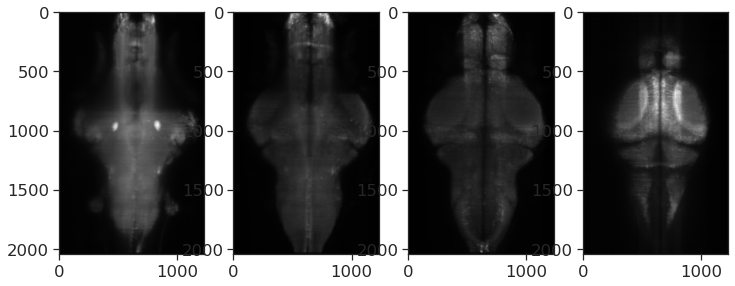

In [52]:
m_clusters = 5 #len(np.unique(labels_))
my_cmap = ListedColormap(sns.color_palette("hls", m_clusters*2).as_hex())
ranges_ = [(0, 13), (13, 19), (19, 25), (25, 31)]

fig, ax = plt.subplots(1, len(ranges_), figsize=(12, 6))
ax = ax.flatten()
for n_layer in range(len(ranges_)):
    min_, max_ = ranges_[n_layer]
    ax[n_layer].imshow(brain_map[min_:max_].max(0).T, cmap='gray')

A_center_ = A_center[arr_vis & ~mpulse_]
z_step = 5
A_center_[:, 0] = A_center_[:, 0]*z_step
db = DBSCAN(eps=30, min_samples=10).fit(A_center_)
db_labels = db.labels_
for n_layer in range(len(ranges_)):
    min_, max_ = ranges_[n_layer]
    layer_ = (A_center_[:, 0]>=min_*z_step) & (A_center_[:, 0]<max_*z_step)
    idx_ = layer_ & (db_labels>=0)
    ax[n_layer].plot(A_center_[idx_, 1], A_center_[idx_, 2], '.b', ms=4)

A_center_ = A_center[mpulse_]
z_step = 5
A_center_[:, 0] = A_center_[:, 0]*z_step    
for m in range(5):
    if (mpulse_labels==m).sum()==0:
        continue
    db = DBSCAN(eps=30, min_samples=10).fit(A_center_[mpulse_labels==m])
    db_labels = -np.ones(mpulse_.sum())
    db_labels[mpulse_labels==m] = db.labels_
    for n_layer in range(len(ranges_)):
        min_, max_ = ranges_[n_layer]
        layer_ = (A_center_[:, 0]>=min_*z_step) & (A_center_[:, 0]<max_*z_step)
        idx_ = layer_ & (db_labels>=0) & arr_vis[mpulse_]
        ax[n_layer].scatter(A_center_[idx_, 1], A_center_[idx_, 2], c=m*2+np.ones(idx_.sum()), cmap=my_cmap, vmin=0, vmax=m_clusters*2-1, s=5)


[_.set_axis_off() for _ in ax]
plt.tight_layout()
plt.show()

In [ ]:
plt.plot(np.arange(-t_pre, t_post)/3,active_resp[~motor_ & ~mpulse_ & arr_].mean(axis=0)*100)
plt.plot(np.arange(-t_pre, t_post)/3,passive_resp[~motor_ & ~mpulse_ & arr_].mean(axis=0)*100)
plt.ylabel('dFF (%)')
plt.xlabel('Time from pulse epoch on (sec)')
sns.despine()
plt.show()

In [ ]:
fig, ax = plt.subplots(6, brain_map.shape[0]//6+1, figsize=(40, 32))
ax = ax.flatten()
for n_layer in range(brain_map.shape[0]):
    ax[n_layer].imshow(brain_map[n_layer], cmap='gray')
    layer_ = A_center[:, 0]==n_layer    
    ax[n_layer].plot(A_center[arr_ & layer_, 2], A_center[arr_ & layer_, 1], '.r', alpha=0.8)
    
[_.set_axis_off() for _ in ax]
plt.tight_layout()
plt.show()

In [ ]:
dat_stats = cell_no_swim_ap_stats
# dat_stats = cell_pulse_swim_ap_stats
t_pre = 5
t_post = 10

pulse_active_vec_sel = np.zeros(num_cells).astype('int')

for n in range(num_cells):
    pulse_active_vec_sel[n] = (dat_stats[n][0][0][3:]<0.05).sum()
    
arr_ = pulse_active_vec_sel>6

active_resp = np.zeros((num_cells, t_pre+t_post))
passive_resp = np.zeros((num_cells, t_pre+t_post))

for n in range(num_cells):
    active_resp[n] = dat_stats[n][4]
    passive_resp[n] = dat_stats[n][5]

In [ ]:
arr_ = pulse_active_vec_sel>=3
plt.plot(np.arange(-t_pre, t_post)/3,active_resp[arr_ & ~motor_ & ~mpulse_].mean(axis=0)*100)
plt.plot(np.arange(-t_pre, t_post)/3,passive_resp[arr_ & ~motor_ & ~mpulse_].mean(axis=0)*100)
plt.ylabel('dFF (%)')
plt.xlabel('Time from swim on (sec)')
sns.despine()
plt.show()

In [ ]:
arr_ = pulse_active_vec_sel>=3
plt.plot(np.arange(-t_pre, t_post)/3,active_resp[arr_ & motor_ & ~mpulse_].mean(axis=0)*100)
plt.plot(np.arange(-t_pre, t_post)/3,passive_resp[arr_ & motor_ & ~mpulse_].mean(axis=0)*100)
plt.ylabel('dFF (%)')
plt.xlabel('Time from swim on (sec)')
sns.despine()
plt.show()

In [ ]:
dat_stats = cell_no_swim_ap_stats
t_pre = 5
t_post = 10
pulse_active_vec_sel = np.zeros(num_cells).astype('int')
for n in range(num_cells):
    pulse_active_vec_sel[n] = (dat_stats[n][0][0][3:]<0.05).sum()
    
arr1_ = pulse_active_vec_sel>=3

dat_stats = cell_pulse_swim_ap_stats
t_pre = 5
t_post = 10
pulse_active_vec_sel = np.zeros(num_cells).astype('int')
for n in range(num_cells):
    pulse_active_vec_sel[n] = (dat_stats[n][0][0][3:]<0.05).sum()
    
arr2_ = pulse_active_vec_sel>=3

In [ ]:
fig, ax = plt.subplots(6, brain_map.shape[0]//6+1, figsize=(40, 32))
ax = ax.flatten()
for n_layer in range(brain_map.shape[0]):
    ax[n_layer].imshow(brain_map[n_layer], cmap='gray')
    layer_ = A_center[:, 0]==n_layer    
    ax[n_layer].plot(A_center[arr1_ & layer_, 2], A_center[arr1_ & layer_, 1], '.r', alpha=0.8)
    ax[n_layer].plot(A_center[arr2_ & layer_, 2], A_center[arr2_ & layer_, 1], '.b', alpha=0.8)
    
[_.set_axis_off() for _ in ax]
plt.tight_layout()
plt.show()